<a href="https://colab.research.google.com/github/saras2005/cyberguard-nlp-hackathon/blob/main/final17012026.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
DRIVE_BATCH_DIR = "/content/drive/MyDrive/PA"

PROJECT_DIR = "/content/project"
RAW_DIR = f"{PROJECT_DIR}/dataset/raw"
PREVIEW_DIR = f"{PROJECT_DIR}/dataset/preview"
LOG_DIR = f"{PROJECT_DIR}/dataset/logs"

import os
os.makedirs(RAW_DIR, exist_ok=True)
os.makedirs(PREVIEW_DIR, exist_ok=True)
os.makedirs(LOG_DIR, exist_ok=True)

print("Directories ready.")


Directories ready.


In [4]:
from pathlib import Path

IMAGE_EXTS = (".jpg", ".jpeg", ".png", ".webp")

drive_images = [
    str(p) for p in Path(DRIVE_BATCH_DIR).rglob("*")
    if p.suffix.lower() in IMAGE_EXTS
]

print("Images found in Drive:", len(drive_images))
drive_images[:5]


Images found in Drive: 14


['/content/drive/MyDrive/PA/26πé╡πâ│πâùπâ½Θ½ÿA_IMG_0613.JPG',
 '/content/drive/MyDrive/PA/26πé╡πâ│πâùπâ½Θ½ÿA_IMG_0614.JPG',
 '/content/drive/MyDrive/PA/26πé╡πâ│πâùπâ½Θ½ÿA_IMG_0908.JPG',
 '/content/drive/MyDrive/PA/26πé╡πâ│πâùπâ½Θ½ÿA_IMG_0911.JPG',
 '/content/drive/MyDrive/PA/26πé╡πâ│πâùπâ½Θ½ÿA_IMG_0910.JPG']

In [5]:
from PIL import Image, ImageOps

normalized_paths = []

for idx, src_path in enumerate(drive_images):
    try:
        img = Image.open(src_path)
        img = ImageOps.exif_transpose(img)  # ✅ FIX ORIENTATION ONCE
        img = img.convert("RGB")

        dst_name = f"img_{idx:05d}.jpg"
        dst_path = os.path.join(RAW_DIR, dst_name)

        img.save(dst_path, quality=95)
        normalized_paths.append(dst_path)

    except Exception as e:
        print("Failed:", src_path, e)

print("Normalized images:", len(normalized_paths))


Normalized images: 14


In [6]:
def create_preview(src, dst, max_size=1280):
    img = Image.open(src)
    img.thumbnail((max_size, max_size))
    img.save(dst, quality=85)

preview_paths = []

for p in normalized_paths:
    out = os.path.join(PREVIEW_DIR, os.path.basename(p))
    create_preview(p, out)
    preview_paths.append(out)

print("Previews created:", len(preview_paths))


Previews created: 14


In [7]:
import json
from datetime import datetime

index = {
    "batch_id": f"BATCH_{datetime.now().strftime('%Y%m%d_%H%M%S')}",
    "source": "google_drive",
    "drive_path": DRIVE_BATCH_DIR,
    "images": []
}

for i, p in enumerate(normalized_paths):
    index["images"].append({
        "image_id": f"img_{i:05d}",
        "raw_path": p,
        "preview_path": os.path.join(PREVIEW_DIR, os.path.basename(p)),
        "status": "ingested",
        "faces_detected": False,
        "assigned_person": None,
        "card_candidate": False
    })

with open(f"{PROJECT_DIR}/dataset/index.json", "w") as f:
    json.dump(index, f, indent=2)

print("Index saved.")


Index saved.


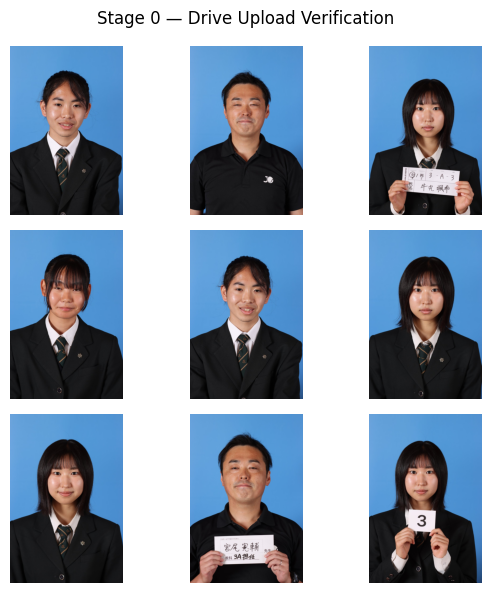

In [8]:
import random
import matplotlib.pyplot as plt

samples = random.sample(preview_paths, min(9, len(preview_paths)))

plt.figure(figsize=(6,6))
for i, p in enumerate(samples):
    plt.subplot(3,3,i+1)
    plt.imshow(Image.open(p))
    plt.axis("off")

plt.suptitle("Stage 0 — Drive Upload Verification")
plt.tight_layout()
plt.show()


In [9]:
!pip install -q ultralytics


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 32.1 MB/s eta 0:00:00


In [10]:
import os

BASE = "/content/project"

DIRS = [
    "dataset/raw",
    "dataset/preview",
    "dataset/faces",
    "dataset/face_vis",
    "dataset/logs"
]

for d in DIRS:
    os.makedirs(os.path.join(BASE, d), exist_ok=True)

print("✅ Folder structure created")


✅ Folder structure created


In [11]:
!wget -q https://github.com/derronqi/yolov8-face/releases/download/v1.0/yolov8n-face.pt
!ls -lh yolov8n-face.pt


ls: cannot access 'yolov8n-face.pt': No such file or directory


In [12]:
!pip install -q insightface onnxruntime-gpu


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 439.5/439.5 kB 13.5 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 300.5/300.5 MB 4.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 2.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.5/17.5 MB 81.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 7.7 MB/s eta 0:00:00


In [13]:
from insightface.app import FaceAnalysis
import torch

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
print("Using device:", DEVICE)

app = FaceAnalysis(
    name="buffalo_l",   # RetinaFace + ArcFace combo
    providers=["CUDAExecutionProvider", "CPUExecutionProvider"]
)

app.prepare(ctx_id=0 if DEVICE=="cuda" else -1)
print("✅ RetinaFace loaded successfully")


Using device: cuda
download_path: /root/.insightface/models/buffalo_l


100%|██████████| 281857/281857 [00:02<00:00, 94697.20KB/s]


Applied providers: ['CUDAExecutionProvider', 'CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}, 'CUDAExecutionProvider': {'sdpa_kernel': '0', 'use_tf32': '1', 'fuse_conv_bias': '0', 'prefer_nhwc': '0', 'tunable_op_max_tuning_duration_ms': '0', 'enable_skip_layer_norm_strict_mode': '0', 'tunable_op_tuning_enable': '0', 'tunable_op_enable': '0', 'use_ep_level_unified_stream': '0', 'device_id': '0', 'has_user_compute_stream': '0', 'gpu_external_empty_cache': '0', 'cudnn_conv_algo_search': 'EXHAUSTIVE', 'cudnn_conv1d_pad_to_nc1d': '0', 'gpu_mem_limit': '18446744073709551615', 'gpu_external_alloc': '0', 'gpu_external_free': '0', 'arena_extend_strategy': 'kNextPowerOfTwo', 'do_copy_in_default_stream': '1', 'enable_cuda_graph': '0', 'user_compute_stream': '0', 'cudnn_conv_use_max_workspace': '1'}}
find model: /root/.insightface/models/buffalo_l/1k3d68.onnx landmark_3d_68 ['None', 3, 192, 192] 0.0 1.0
Applied providers: ['CUDAExecutionProvider', 'CPUExecutionProvider'], with o

In [14]:
import json, os

INDEX_PATH = "/content/project/dataset/index.json"
assert os.path.exists(INDEX_PATH), "❌ index.json missing"

with open(INDEX_PATH, "r") as f:
    index_data = json.load(f)

images = index_data["images"]
print("Images in batch:", len(images))


Images in batch: 14


In [15]:
import cv2
import os

FACE_DIR = "/content/project/dataset/faces"
VIS_DIR  = "/content/project/dataset/face_vis"

os.makedirs(FACE_DIR, exist_ok=True)
os.makedirs(VIS_DIR, exist_ok=True)

for img_entry in images:
    img_path = img_entry["raw_path"]
    img_id   = img_entry["image_id"]

    img = cv2.imread(img_path)
    if img is None:
        img_entry["faces_detected"] = False
        img_entry["faces"] = []
        continue

    faces_detected = app.get(img)

    vis_img = img.copy()
    faces = []

    for i, face in enumerate(faces_detected):
        x1, y1, x2, y2 = map(int, face.bbox)

        # Safety clamp
        h, w, _ = img.shape
        x1, y1 = max(0,x1), max(0,y1)
        x2, y2 = min(w-1,x2), min(h-1,y2)

        if x2 <= x1 or y2 <= y1:
            continue

        face_crop = img[y1:y2, x1:x2]
        face_name = f"{img_id}_f{i}.jpg"
        face_path = os.path.join(FACE_DIR, face_name)
        cv2.imwrite(face_path, face_crop)

        faces.append({
            "face_id": f"{img_id}_f{i}",
            "bbox": [x1,y1,x2,y2],
            "face_path": face_path
        })

        cv2.rectangle(vis_img, (x1,y1), (x2,y2), (0,255,0), 2)

    cv2.imwrite(os.path.join(VIS_DIR, f"{img_id}.jpg"), vis_img)

    img_entry["faces_detected"] = len(faces) > 0
    img_entry["faces"] = faces


In [16]:
with open(INDEX_PATH, "w") as f:
    json.dump(index_data, f, indent=2)

print("✅ Index updated with RetinaFace results")


✅ Index updated with RetinaFace results


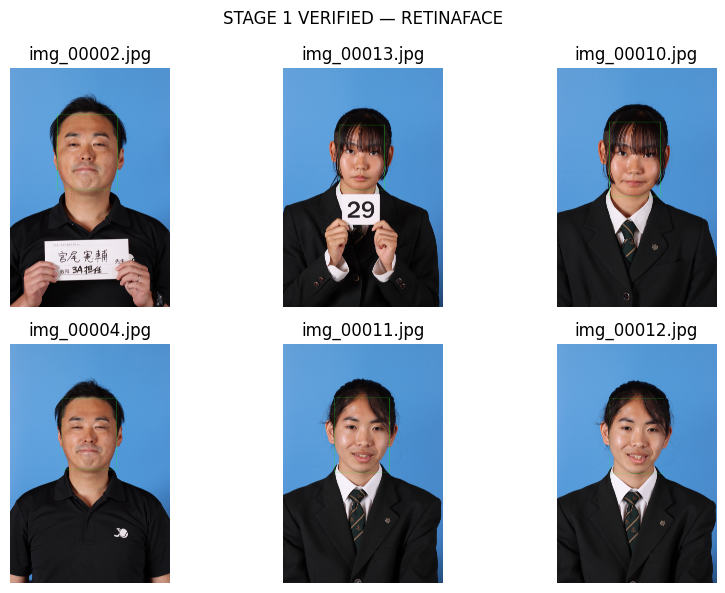

In [17]:
import random
import matplotlib.pyplot as plt
from PIL import Image

vis_files = os.listdir(VIS_DIR)
assert len(vis_files) > 0, "❌ No face visualization files found"

sample = random.sample(vis_files, min(6, len(vis_files)))

plt.figure(figsize=(9,6))
for i, f in enumerate(sample):
    plt.subplot(2,3,i+1)
    plt.imshow(Image.open(os.path.join(VIS_DIR, f)))
    plt.title(f)
    plt.axis("off")

plt.suptitle("STAGE 1 VERIFIED — RETINAFACE")
plt.tight_layout()
plt.show()


In [18]:
import os

EMB_DIR = "/content/project/dataset/embeddings"
PERSON_DIR = "/content/project/dataset/persons"

os.makedirs(EMB_DIR, exist_ok=True)
os.makedirs(PERSON_DIR, exist_ok=True)

print("✅ Embedding & person directories ready")


✅ Embedding & person directories ready


In [19]:
import json

INDEX_PATH = "/content/project/dataset/index.json"

with open(INDEX_PATH, "r") as f:
    index_data = json.load(f)

images = index_data["images"]

# Count faces
total_faces = sum(len(img.get("faces", [])) for img in images)
print("Images:", len(images))
print("Total detected faces:", total_faces)


Images: 14
Total detected faces: 14


In [20]:
import numpy as np
import cv2

face_embeddings = []
face_records = []

for img in images:
    for face in img.get("faces", []):
        face_img = cv2.imread(face["face_path"])
        if face_img is None:
            continue

        # InsightFace returns embedding directly
        detected = app.get(face_img)
        if len(detected) == 0:
            continue

        emb = detected[0].embedding  # 512-d vector

        emb_path = os.path.join(
            EMB_DIR, f"{face['face_id']}.npy"
        )
        np.save(emb_path, emb)

        face_embeddings.append(emb)
        face_records.append({
            "face_id": face["face_id"],
            "image_id": img["image_id"],
            "embedding_path": emb_path
        })

print("✅ Embeddings extracted:", len(face_embeddings))


✅ Embeddings extracted: 0


In [21]:
!pip install -q hdbscan


In [22]:
import numpy as np
import cv2
import os

face_embeddings = []
face_records = []

for img_entry in images:
    img_path = img_entry["raw_path"]
    img_id   = img_entry["image_id"]

    img = cv2.imread(img_path)
    if img is None:
        continue

    # 🔥 Detect faces ON ORIGINAL IMAGE
    detected_faces = app.get(img)

    for i, face in enumerate(detected_faces):
        emb = face.embedding
        if emb is None:
            continue

        face_id = f"{img_id}_f{i}"
        emb_path = os.path.join(EMB_DIR, f"{face_id}.npy")
        np.save(emb_path, emb)

        face_embeddings.append(emb)
        face_records.append({
            "face_id": face_id,
            "image_id": img_id,
            "embedding_path": emb_path
        })

print("✅ Embeddings extracted:", len(face_embeddings))


✅ Embeddings extracted: 14


In [23]:
import numpy as np

sample_emb = np.load(face_records[0]["embedding_path"])
print("Embedding shape:", sample_emb.shape)


Embedding shape: (512,)


In [24]:
import hdbscan
import numpy as np

X = np.vstack(face_embeddings)

clusterer = hdbscan.HDBSCAN(
    min_cluster_size=2,
    metric="euclidean"
)

labels = clusterer.fit_predict(X)
print("Cluster labels:", labels)


Cluster labels: [ 1  1  0  0  0  0  1  1  1  2  2  2 -1  2]


/usr/local/lib/python3.12/dist-packages/hdbscan/robust_single_linkage_.py:175: SyntaxWarning: invalid escape sequence '\{'
  $max \{ core_k(a), core_k(b), 1/\alpha d(a,b) \}$.


In [25]:
import os, json, shutil
from collections import defaultdict

INDEX_PATH = "/content/project/dataset/index.json"
PERSON_DIR = "/content/project/dataset/persons"

with open(INDEX_PATH, "r") as f:
    index_data = json.load(f)

# 1️⃣ Build face_id → person_id mapping
face_to_person = {}

for person in os.listdir(PERSON_DIR):
    face_dir = os.path.join(PERSON_DIR, person, "faces")
    for f in os.listdir(face_dir):
        if f.endswith(".jpg"):
            face_id = f.replace(".jpg", "")
            face_to_person[face_id] = person

print("Mapped faces to persons:", len(face_to_person))


Mapped faces to persons: 0


In [26]:
# Rebuild label -> person mapping explicitly
unique_labels = sorted(set(labels))
label_to_person = {}

for lbl in unique_labels:
    if lbl == -1:
        continue
    label_to_person[lbl] = f"Person_{lbl:03d}"

label_to_person


{np.int64(0): 'Person_000',
 np.int64(1): 'Person_001',
 np.int64(2): 'Person_002'}

In [27]:
import shutil, os, json

PERSON_DIR = "/content/project/dataset/persons"
FACE_SRC_DIR = "/content/project/dataset/faces"

# Remove old persons folder completely
if os.path.exists(PERSON_DIR):
    shutil.rmtree(PERSON_DIR)

os.makedirs(PERSON_DIR, exist_ok=True)

print("✅ Person directory reset")


✅ Person directory reset


In [28]:
# face_records and labels MUST already exist in memory
# If not, STOP and tell me

from collections import defaultdict

person_faces = defaultdict(list)

for rec, lbl in zip(face_records, labels):
    if lbl == -1:
        continue
    person_id = label_to_person[lbl]
    person_faces[person_id].append(rec)

# Create folders and copy faces
for person_id, records in person_faces.items():
    person_path = os.path.join(PERSON_DIR, person_id)
    os.makedirs(person_path, exist_ok=True)
    os.makedirs(os.path.join(person_path, "faces"), exist_ok=True)
    os.makedirs(os.path.join(person_path, "images"), exist_ok=True)

    for rec in records:
        src = os.path.join(
            "/content/project/dataset/faces",
            f"{rec['face_id']}.jpg"
        )
        dst = os.path.join(
            person_path, "faces", f"{rec['face_id']}.jpg"
        )
        if os.path.exists(src):
            shutil.copy(src, dst)

    meta = {
        "person_id": person_id,
        "face_count": len(records),
        "card_image": None,
        "name": None,
        "verified": False
    }

    with open(os.path.join(person_path, "metadata.json"), "w") as f:
        json.dump(meta, f, indent=2)

print("✅ Person folders recreated with faces")


✅ Person folders recreated with faces


In [29]:
for person in sorted(os.listdir(PERSON_DIR)):
    face_dir = os.path.join(PERSON_DIR, person, "faces")
    print(person, "faces:", len(os.listdir(face_dir)))


Person_000 faces: 4
Person_001 faces: 5
Person_002 faces: 4


In [30]:
face_to_person = {}

for person in os.listdir(PERSON_DIR):
    face_dir = os.path.join(PERSON_DIR, person, "faces")
    for f in os.listdir(face_dir):
        if f.endswith(".jpg"):
            face_to_person[f.replace(".jpg","")] = person

print("Mapped faces to persons:", len(face_to_person))


Mapped faces to persons: 13


In [31]:
import shutil

# Clear images folders
for person in os.listdir(PERSON_DIR):
    img_dir = os.path.join(PERSON_DIR, person, "images")
    for f in os.listdir(img_dir):
        os.remove(os.path.join(img_dir, f))

# Assign images
for img in index_data["images"]:
    img_id = img["image_id"]
    raw_path = img["raw_path"]

    for face in img.get("faces", []):
        fid = face["face_id"]
        if fid in face_to_person:
            person = face_to_person[fid]
            dst = os.path.join(PERSON_DIR, person, "images", f"{img_id}.jpg")
            if not os.path.exists(dst):
                shutil.copy(raw_path, dst)


In [32]:
for person in sorted(os.listdir(PERSON_DIR)):
    imgs = os.listdir(os.path.join(PERSON_DIR, person, "images"))
    print(person, "→", len(imgs), "images")


Person_000 → 4 images
Person_001 → 5 images
Person_002 → 4 images


In [33]:
!pip install -q open_clip_torch pillow


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 22.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 2.2 MB/s eta 0:00:00


In [34]:
import torch
import open_clip

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
print("Using device:", DEVICE)

model, _, preprocess = open_clip.create_model_and_transforms(
    model_name="ViT-B-32",
    pretrained="laion2b_s34b_b79k"
)

tokenizer = open_clip.get_tokenizer("ViT-B-32")

model = model.to(DEVICE)
model.eval()

print("✅ OpenCLIP loaded")


Using device: cuda


/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


open_clip_model.safetensors:   0%|          | 0.00/605M [00:00<?, ?B/s]

✅ OpenCLIP loaded


In [35]:
CARD_PROMPTS = [
    "a person holding a name card",
    "a person holding an ID card",
    "a person holding a paper card with text",
    "a person holding a card with numbers"
]

text_tokens = tokenizer(CARD_PROMPTS).to(DEVICE)

with torch.no_grad():
    text_features = model.encode_text(text_tokens)
    text_features /= text_features.norm(dim=-1, keepdim=True)

print("✅ Text prompts encoded")


✅ Text prompts encoded


In [36]:
from PIL import Image
import numpy as np

def card_score(image_path):
    image = Image.open(image_path).convert("RGB")
    image_input = preprocess(image).unsqueeze(0).to(DEVICE)

    with torch.no_grad():
        image_features = model.encode_image(image_input)
        image_features /= image_features.norm(dim=-1, keepdim=True)

        # cosine similarity with all prompts
        similarity = (image_features @ text_features.T).squeeze(0)

    return similarity.max().item()


In [37]:
import os, json

PERSON_DIR = "/content/project/dataset/persons"
CARD_THRESHOLD = 0.28  # safe default

for person in sorted(os.listdir(PERSON_DIR)):
    person_path = os.path.join(PERSON_DIR, person)
    img_dir = os.path.join(person_path, "images")
    meta_path = os.path.join(person_path, "metadata.json")

    with open(meta_path, "r") as f:
        meta = json.load(f)

    best_img = None
    best_score = -1.0

    for img_name in sorted(os.listdir(img_dir)):
        img_path = os.path.join(img_dir, img_name)
        score = card_score(img_path)

        if score > best_score:
            best_score = score
            best_img = img_name

    if best_score >= CARD_THRESHOLD:
        meta["card_image"] = best_img
        meta["card_score"] = round(best_score, 3)
    else:
        meta["card_image"] = None
        meta["card_score"] = round(best_score, 3)

    with open(meta_path, "w") as f:
        json.dump(meta, f, indent=2)

    print(person, "→", meta["card_image"], "(score:", meta["card_score"], ")")


Person_000 → img_00002.jpg (score: 0.32 )
Person_001 → img_00008.jpg (score: 0.341 )
Person_002 → img_00013.jpg (score: 0.337 )


Person_000 | score: 0.32 | card: img_00002.jpg


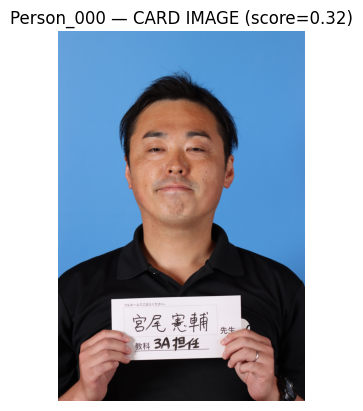

Person_001 | score: 0.341 | card: img_00008.jpg


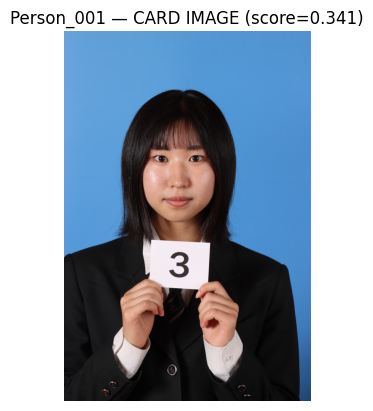

Person_002 | score: 0.337 | card: img_00013.jpg


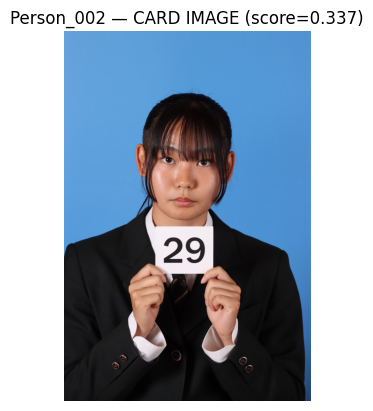

In [38]:
import matplotlib.pyplot as plt
from PIL import Image

for person in sorted(os.listdir(PERSON_DIR)):
    meta = json.load(open(os.path.join(PERSON_DIR, person, "metadata.json")))
    card = meta.get("card_image")
    score = meta.get("card_score")

    print(person, "| score:", score, "| card:", card)

    if card:
        img_path = os.path.join(PERSON_DIR, person, "images", card)
        plt.imshow(Image.open(img_path))
        plt.title(f"{person} — CARD IMAGE (score={score})")
        plt.axis("off")
        plt.show()


In [39]:
import os, json

PERSON_DIR = "/content/project/dataset/persons"
CARD_THRESHOLD = 0.28  # same threshold as before

for person in sorted(os.listdir(PERSON_DIR)):
    person_path = os.path.join(PERSON_DIR, person)
    img_dir = os.path.join(person_path, "images")
    meta_path = os.path.join(person_path, "metadata.json")

    with open(meta_path, "r") as f:
        meta = json.load(f)

    detected_cards = []

    for img_name in sorted(os.listdir(img_dir)):
        img_path = os.path.join(img_dir, img_name)
        score = card_score(img_path)

        if score >= CARD_THRESHOLD:
            detected_cards.append({
                "image": img_name,
                "score": round(score, 3)
            })

    # sort by confidence (highest first)
    detected_cards = sorted(
        detected_cards,
        key=lambda x: x["score"],
        reverse=True
    )

    meta["card_images"] = detected_cards

    with open(meta_path, "w") as f:
        json.dump(meta, f, indent=2)

    print(
        person,
        "→",
        len(detected_cards),
        "card images"
    )


Person_000 → 1 card images
Person_001 → 2 card images
Person_002 → 1 card images


Person_000 → 1 card images


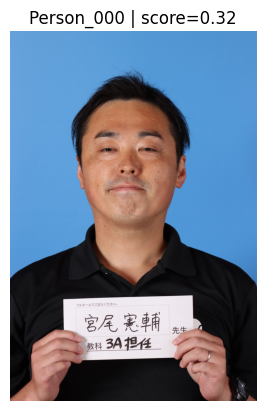

Person_001 → 2 card images


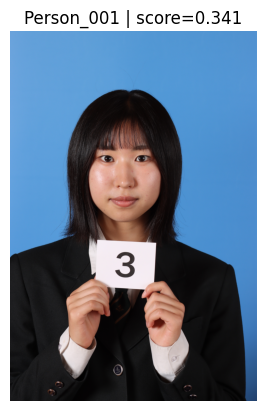

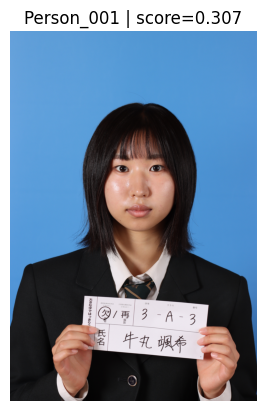

Person_002 → 1 card images


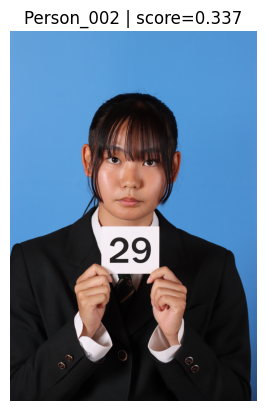

In [40]:
import matplotlib.pyplot as plt
from PIL import Image

for person in sorted(os.listdir(PERSON_DIR)):
    meta = json.load(open(os.path.join(PERSON_DIR, person, "metadata.json")))
    cards = meta.get("card_images", [])

    print(person, "→", len(cards), "card images")

    for item in cards:
        img_path = os.path.join(
            PERSON_DIR,
            person,
            "images",
            item["image"]
        )
        plt.imshow(Image.open(img_path))
        plt.title(
            f"{person} | score={item['score']}"
        )
        plt.axis("off")
        plt.show()


In [41]:
import os

PERSON_DIR = "/content/project/dataset/persons"

for person in os.listdir(PERSON_DIR):
    base = os.path.join(PERSON_DIR, person)
    os.makedirs(os.path.join(base, "card_crops"), exist_ok=True)
    os.makedirs(os.path.join(base, "card_vis"), exist_ok=True)

print("✅ Card crop directories ready")


✅ Card crop directories ready


In [42]:
!pip install -q supervision timm

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 212.4/212.4 kB 8.2 MB/s eta 0:00:00


In [43]:
!pip uninstall -y groundingdino supervision timm addict yapf pycocotools


Found existing installation: supervision 0.27.0
Uninstalling supervision-0.27.0:
  Successfully uninstalled supervision-0.27.0
Found existing installation: timm 1.0.24
Uninstalling timm-1.0.24:
  Successfully uninstalled timm-1.0.24
Found existing installation: pycocotools 2.0.11
Uninstalling pycocotools-2.0.11:
  Successfully uninstalled pycocotools-2.0.11


In [44]:
!pip install -q torch torchvision torchaudio


In [45]:
!pip install -q supervision timm addict yapf pycocotools opencv-python matplotlib pillow


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.8/46.8 kB 5.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.6/2.6 MB 57.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 256.2/256.2 kB 22.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 411.7/411.7 kB 40.2 MB/s eta 0:00:00


In [46]:
!rm -rf GroundingDINO
!git clone https://github.com/IDEA-Research/GroundingDINO.git


Cloning into 'GroundingDINO'...
remote: Enumerating objects: 463, done.
remote: Total 463 (delta 0), reused 0 (delta 0), pack-reused 463 (from 1)
Receiving objects: 100% (463/463), 12.91 MiB | 47.04 MiB/s, done.
Resolving deltas: 100% (221/221), done.


In [47]:
!wget -O GroundingDINO/groundingdino_swint_ogc.pth \
https://github.com/IDEA-Research/GroundingDINO/releases/download/v0.1.0-alpha/groundingdino_swint_ogc.pth


--2026-01-17 21:33:48--  https://github.com/IDEA-Research/GroundingDINO/releases/download/v0.1.0-alpha/groundingdino_swint_ogc.pth
Resolving github.com (github.com)... 140.82.116.4
Connecting to github.com (github.com)|140.82.116.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://release-assets.githubusercontent.com/github-production-release-asset/611591640/f221e500-c2fc-4fd3-b84e-8ad92a6923f3?sp=r&sv=2018-11-09&sr=b&spr=https&se=2026-01-17T22%3A22%3A15Z&rscd=attachment%3B+filename%3Dgroundingdino_swint_ogc.pth&rsct=application%2Foctet-stream&skoid=96c2d410-5711-43a1-aedd-ab1947aa7ab0&sktid=398a6654-997b-47e9-b12b-9515b896b4de&skt=2026-01-17T21%3A21%3A58Z&ske=2026-01-17T22%3A22%3A15Z&sks=b&skv=2018-11-09&sig=121zXMjMIMzVYcpGDnyycwOgQwur9nb2Mfoz%2FfrWsdM%3D&jwt=eyJ0eXAiOiJKV1QiLCJhbGciOiJIUzI1NiJ9.eyJpc3MiOiJnaXRodWIuY29tIiwiYXVkIjoicmVsZWFzZS1hc3NldHMuZ2l0aHVidXNlcmNvbnRlbnQuY29tIiwia2V5Ijoia2V5MSIsImV4cCI6MTc2ODY4OTIyOSwibmJmIjoxNzY4Njg1NjI5LCJwYX

In [48]:
!ls -lh GroundingDINO/groundingdino_swint_ogc.pth


-rw-r--r-- 1 root root 662M Mar 21  2023 GroundingDINO/groundingdino_swint_ogc.pth


In [49]:
import sys
sys.path.append("GroundingDINO")

from groundingdino.util.inference import load_model

print("✅ GroundingDINO code imported")


✅ GroundingDINO code imported


In [50]:
!ls -l


total 16
drwx------ 5 root root 4096 Jan 17 21:30 drive
drwxr-xr-x 6 root root 4096 Jan 17 21:33 GroundingDINO
drwxr-xr-x 3 root root 4096 Jan 17 21:30 project
drwxr-xr-x 1 root root 4096 Dec  9 14:42 sample_data


In [51]:
import sys
sys.path.insert(0, "/content/GroundingDINO")


In [52]:
from groundingdino.util.inference import load_model
print("✅ GroundingDINO imported successfully")


✅ GroundingDINO imported successfully


In [53]:
import torch

DINO_DEVICE = "cpu"  # FORCE SAFE MODE

dino = load_model(
    "/content/GroundingDINO/groundingdino/config/GroundingDINO_SwinT_OGC.py",
    "/content/GroundingDINO/groundingdino_swint_ogc.pth"
)

dino = dino.to(DINO_DEVICE)
dino.eval()

print("✅ GroundingDINO loaded in SAFE CPU mode")


final text_encoder_type: bert-base-uncased


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

✅ GroundingDINO loaded in SAFE CPU mode


Detected boxes: 1


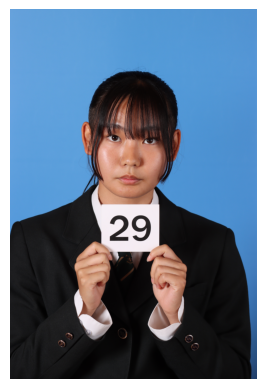

In [54]:
from groundingdino.util.inference import load_image, predict
import matplotlib.pyplot as plt

TEST_IMAGE = "/content/project/dataset/raw/" + os.listdir("/content/project/dataset/raw")[0]

image_source, image = load_image(TEST_IMAGE)

boxes, scores, labels = predict(
    model=dino,
    image=image,
    caption="a paper card with text",
    box_threshold=0.3,
    text_threshold=0.25,
    device=DINO_DEVICE
)

print("Detected boxes:", len(boxes))

plt.imshow(image_source)
plt.axis("off")
plt.show()


In [55]:
from PIL import Image, ImageOps
import numpy as np

def load_image_fixed(path):
    """
    Loads image and fixes EXIF orientation.
    Returns RGB numpy array.
    """
    img = Image.open(path)
    img = ImageOps.exif_transpose(img)  # 🔥 FIX ROTATION
    return np.array(img.convert("RGB"))


In [56]:
from PIL import Image, ImageOps
import numpy as np

def load_image_fixed(path):
    """
    Loads image, fixes EXIF orientation, returns RGB numpy array.
    """
    img = Image.open(path)
    img = ImageOps.exif_transpose(img)
    return np.array(img.convert("RGB"))


Person_000 | img_00002.jpg | score=0.32


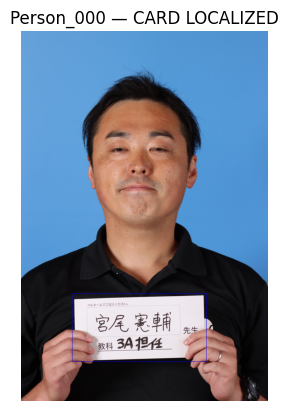

Person_001 | img_00008.jpg | score=0.341


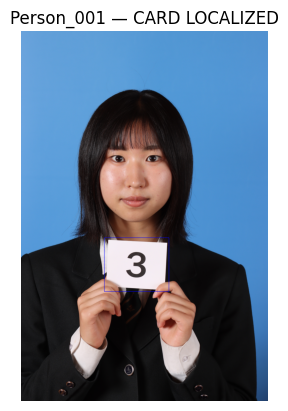

Person_001 | img_00000.jpg | score=0.307


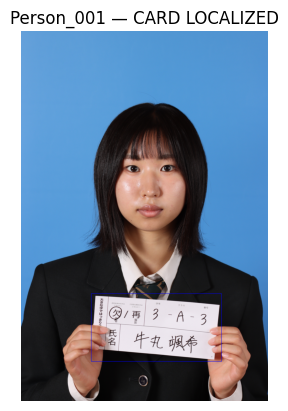

Person_002 | img_00013.jpg | score=0.337


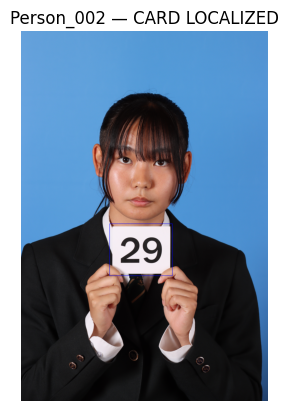

In [57]:
import os, json, cv2
import matplotlib.pyplot as plt
import numpy as np
from groundingdino.util.inference import load_image, predict

PERSON_DIR = "/content/project/dataset/persons"
DINO_DEVICE = "cpu"   # SAFE MODE

for person in sorted(os.listdir(PERSON_DIR)):
    person_path = os.path.join(PERSON_DIR, person)
    meta_path = os.path.join(person_path, "metadata.json")

    meta = json.load(open(meta_path))
    card_images = meta.get("card_images", [])

    if len(card_images) == 0:
        print(person, "→ no card images (skipped)")
        continue

    for item in card_images:
        img_name = item["image"]
        img_path = os.path.join(person_path, "images", img_name)

        # 🔹 1. Load image for GroundingDINO (torch tensor)
        image_source_dino, image_tensor = load_image(img_path)
        H, W, _ = image_source_dino.shape

        # 🔹 2. Load image for visualization (EXIF fixed)
        image_vis = load_image_fixed(img_path)

        # 🔹 3. Run GroundingDINO ONLY on card images
        boxes, scores, labels = predict(
            model=dino,
            image=image_tensor,   # ✅ torch tensor
            caption="a paper card with text or numbers",
            box_threshold=0.35,
            text_threshold=0.25,
            device=DINO_DEVICE
        )

        if len(boxes) == 0:
            print(person, img_name, "→ ❌ no card localized")
            continue

        # 🔹 4. Select highest confidence box
        best = int(np.argmax(scores))
        cx, cy, bw, bh = boxes[best]

        # normalized → absolute
        cx, cy = cx * W, cy * H
        bw, bh = bw * W, bh * H

        # 🔹 5. Stabilize crop
        bw = max(bw, 40)
        bh = max(bh, 25)
        pad = 10
        bw += pad * 2
        bh += pad * 2

        x1 = int(max(0, cx - bw / 2))
        y1 = int(max(0, cy - bh / 2))
        x2 = int(min(W - 1, cx + bw / 2))
        y2 = int(min(H - 1, cy + bh / 2))

        # 🔹 6. Crop card (from EXIF-fixed image)
        card_crop = image_vis[y1:y2, x1:x2]

        # 🔹 7. Save cropped card
        crop_dir = os.path.join(person_path, "card_crops")
        os.makedirs(crop_dir, exist_ok=True)

        crop_name = img_name.replace(".jpg", "_card.jpg")
        crop_path = os.path.join(crop_dir, crop_name)

        cv2.imwrite(crop_path, cv2.cvtColor(card_crop, cv2.COLOR_RGB2BGR))

        # 🔹 8. Draw BORDER for verification (THIS IS FOR YOUR BOSS)
        vis = image_vis.copy()
        cv2.rectangle(
            vis,
            (x1, y1),
            (x2, y2),
            (0, 0, 255),   # 🔴 RED BORDER (clear & visible)
            3
        )

        # 🔹 9. Save visualization
        vis_dir = os.path.join(person_path, "card_vis")
        os.makedirs(vis_dir, exist_ok=True)

        vis_path = os.path.join(vis_dir, img_name)
        cv2.imwrite(vis_path, cv2.cvtColor(vis, cv2.COLOR_RGB2BGR))

        # 🔹 10. SHOW visual verification
        print(f"{person} | {img_name} | score={item['score']}")
        plt.imshow(vis)
        plt.title(f"{person} — CARD LOCALIZED")
        plt.axis("off")
        plt.show()


In [58]:
import time
import os, json
from PIL import Image
import torch




In [59]:
def batch_card_scores(image_paths):
    """
    image_paths: list[str]
    returns: list[float] (card similarity scores)
    """
    imgs = []
    for p in image_paths:
        img = Image.open(p).convert("RGB")
        imgs.append(preprocess(img))

    image_batch = torch.stack(imgs).to(DEVICE)

    with torch.no_grad():
        image_features = model.encode_image(image_batch)
        image_features /= image_features.norm(dim=-1, keepdim=True)
        sims = image_features @ text_features.T
        scores = sims.max(dim=1).values

    return scores.cpu().tolist()


In [60]:
PERSON_DIR = "/content/project/dataset/persons"
CARD_THRESHOLD = 0.28

overall_start = time.time()
person_timings = []

print("\n⚡ STAGE 3 SPEED TEST (BATCHED OPENCLIP)\n")

for person in sorted(os.listdir(PERSON_DIR)):
    person_start = time.time()

    person_path = os.path.join(PERSON_DIR, person)
    img_dir = os.path.join(person_path, "images")
    meta_path = os.path.join(person_path, "metadata.json")

    with open(meta_path, "r") as f:
        meta = json.load(f)

    image_files = sorted(os.listdir(img_dir))
    image_paths = [os.path.join(img_dir, f) for f in image_files]

    if len(image_paths) == 0:
        print(person, "→ no images (skipped)")
        continue

    # 🚀 BATCH INFERENCE
    scores = batch_card_scores(image_paths)

    detected_cards = []
    for img, score in zip(image_files, scores):
        if score >= CARD_THRESHOLD:
            detected_cards.append({
                "image": img,
                "score": round(score, 3)
            })

    detected_cards = sorted(
        detected_cards,
        key=lambda x: x["score"],
        reverse=True
    )

    meta["card_images"] = detected_cards

    with open(meta_path, "w") as f:
        json.dump(meta, f, indent=2)

    elapsed = time.time() - person_start
    person_timings.append(elapsed)

    print(
        f"{person} → {len(detected_cards)} card images | "
        f"time: {elapsed:.3f}s"
    )

overall_time = time.time() - overall_start



⚡ STAGE 3 SPEED TEST (BATCHED OPENCLIP)

Person_000 → 1 card images | time: 1.380s
Person_001 → 2 card images | time: 1.615s
Person_002 → 1 card images | time: 0.917s


In [61]:
import numpy as np

print("\n📊 STAGE 3 PERFORMANCE SUMMARY\n")

print(f"Total persons processed : {len(person_timings)}")
print(f"Total time              : {overall_time:.2f} seconds")
print(f"Avg time per person     : {np.mean(person_timings):.3f} seconds")
print(f"Fastest person          : {np.min(person_timings):.3f} seconds")
print(f"Slowest person          : {np.max(person_timings):.3f} seconds")



📊 STAGE 3 PERFORMANCE SUMMARY

Total persons processed : 3
Total time              : 3.91 seconds
Avg time per person     : 1.304 seconds
Fastest person          : 0.917 seconds
Slowest person          : 1.615 seconds


In [62]:
from PIL import Image, ImageOps
import numpy as np

def load_image_normalized(path):
    """
    Loads image, fixes EXIF orientation, returns RGB numpy array.
    This is the ONLY allowed image loader in the pipeline.
    """
    img = Image.open(path)
    img = ImageOps.exif_transpose(img)  # 🔥 fixes rotation
    return np.array(img.convert("RGB"))


In [63]:
!pip install -q easyocr pillow opencv-python


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 55.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 180.7/180.7 kB 18.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 978.2/978.2 kB 70.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 300.6/300.6 kB 29.3 MB/s eta 0:00:00


In [64]:
!git clone https://github.com/githubharald/gitocr.git
!pip install -q gitocr


Cloning into 'gitocr'...
fatal: could not read Username for 'https://github.com': No such device or address
ERROR: Could not find a version that satisfies the requirement gitocr (from versions: none)
ERROR: No matching distribution found for gitocr


In [65]:
!pip install -q easyocr transformers pillow torch torchvision


In [66]:
import easyocr

easy_reader = easyocr.Reader(
    ['ja', 'en'],
    gpu=False
)

print("✅ EasyOCR loaded")


Progress: |██████████████████████████████████████████████████| 100.0% Complete

Progress: |██████████████████████████████████████████████████| 100.0% Complete✅ EasyOCR loaded


In [67]:
import cv2
import numpy as np

def preprocess_for_handwriting(img_rgb):
    gray = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY)

    # preserve strokes
    gray = cv2.bilateralFilter(gray, 9, 75, 75)

    th = cv2.adaptiveThreshold(
        gray, 255,
        cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
        cv2.THRESH_BINARY,
        31, 2
    )
    return th


In [68]:
from PIL import Image

def run_trocr(img_rgb):
    img_pil = Image.fromarray(img_rgb)

    pixel_values = trocr_processor(
        images=img_pil,
        return_tensors="pt"
    ).pixel_values.to(DEVICE)

    with torch.no_grad():
        generated_ids = trocr_model.generate(
            pixel_values,
            max_length=12
        )

    text = trocr_processor.batch_decode(
        generated_ids,
        skip_special_tokens=True
    )[0]

    return text.strip()


In [69]:
def run_easyocr(img_rgb):
    return easy_reader.readtext(img_rgb)


In [70]:
import re
from collections import Counter

KANJI_RE = re.compile(r'^[\u4e00-\u9fff]{2,4}$')

def extract_candidates(trocr_text, easy_results):
    candidates = []

    if trocr_text and KANJI_RE.match(trocr_text):
        candidates.append(trocr_text)

    for (_, text, conf) in easy_results:
        text = text.strip()
        if conf >= 0.5 and KANJI_RE.match(text):
            candidates.append(text)

    return candidates


def finalize_name(candidates):
    if not candidates:
        return "UNKNOWN", True

    best = Counter(candidates).most_common(1)[0][0]
    return best, False


In [71]:
def run_full_ocr(card_image_path):
    img = Image.open(card_image_path).convert("RGB")
    img = np.array(img)

    pre = preprocess_for_handwriting(img)

    trocr_text = run_trocr(pre)
    easy_results = run_easyocr(pre)

    candidates = extract_candidates(trocr_text, easy_results)
    final_name, needs_review = finalize_name(candidates)

    return {
        "trocr_raw": trocr_text,
        "easyocr_raw": easy_results,
        "candidates": candidates,
        "final_name": final_name,
        "needs_review": needs_review
    }


In [72]:
from transformers import TrOCRProcessor, VisionEncoderDecoderModel
import torch

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
print("Using device:", DEVICE)

trocr_processor = TrOCRProcessor.from_pretrained(
    "microsoft/trocr-base-handwritten"
)

trocr_model = VisionEncoderDecoderModel.from_pretrained(
    "microsoft/trocr-base-handwritten"
).to(DEVICE)

trocr_model.eval()

print("✅ TrOCR processor & model loaded")


Using device: cuda


preprocessor_config.json:   0%|          | 0.00/224 [00:00<?, ?B/s]

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


tokenizer_config.json: 0.00B [00:00, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/772 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

model.safetensors:   0%|          | 0.00/1.33G [00:00<?, ?B/s]

Some weights of VisionEncoderDecoderModel were not initialized from the model checkpoint at microsoft/trocr-base-handwritten and are newly initialized: ['encoder.pooler.dense.bias', 'encoder.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


generation_config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

✅ TrOCR processor & model loaded


In [73]:
print("Trocr test:", run_trocr(
    load_image_normalized(
        os.path.join(
            PERSON_DIR,
            os.listdir(PERSON_DIR)[0],
            "card_crops",
            os.listdir(
                os.path.join(
                    PERSON_DIR,
                    os.listdir(PERSON_DIR)[0],
                    "card_crops"
                )
            )[0]
        )
    )
))


Trocr test: 13 7


In [74]:
from PIL import Image
import numpy as np

def run_full_ocr(card_image_path):
    # Load RGB image (correct orientation already ensured earlier)
    img = Image.open(card_image_path).convert("RGB")
    img = np.array(img)

    # Preprocess ONLY for EasyOCR
    pre = preprocess_for_handwriting(img)

    # 🔑 OCR engines (correct inputs)
    trocr_text = run_trocr(img)          # RGB image
    easy_results = run_easyocr(pre)      # thresholded

    candidates = extract_candidates(trocr_text, easy_results)
    final_name, needs_review = finalize_name(candidates)

    return {
        "trocr_raw": trocr_text,
        "easyocr_raw": easy_results,
        "candidates": candidates,
        "final_name": final_name,
        "needs_review": needs_review
    }


In [75]:
test_person = sorted(os.listdir(PERSON_DIR))[0]
test_crop = os.listdir(
    os.path.join(PERSON_DIR, test_person, "card_crops")
)[0]

test_path = os.path.join(
    PERSON_DIR, test_person, "card_crops", test_crop
)

print(run_full_ocr(test_path))


{'trocr_raw': 'teen recently', 'easyocr_raw': [([[np.int32(186), np.int32(104)], [np.int32(736), np.int32(104)], [np.int32(736), np.int32(179)], [np.int32(186), np.int32(179)]], 'フルネームでこ記入ください。', np.float64(0.6650406647931403)), ([[np.int32(288), np.int32(222)], [np.int32(1317), np.int32(222)], [np.int32(1317), np.int32(528)], [np.int32(288), np.int32(528)]], '宮尾憲輔', np.float64(0.935431718826294)), ([[np.int32(1432), np.int32(418)], [np.int32(1638), np.int32(418)], [np.int32(1638), np.int32(544)], [np.int32(1432), np.int32(544)]], '先生', np.float64(0.05052637763660634)), ([[np.int32(316), np.int32(552)], [np.int32(1190), np.int32(552)], [np.int32(1190), np.int32(750)], [np.int32(316), np.int32(750)]], '教科_弘だs_', np.float64(0.003493294446047313))], 'candidates': ['宮尾憲輔'], 'final_name': '宮尾憲輔', 'needs_review': False}


In [76]:
def run_full_ocr_debug(card_image_path):
    print("\n📄 OCR DEBUG FOR:", card_image_path)

    img = Image.open(card_image_path).convert("RGB")
    img = np.array(img)

    print("• Image shape:", img.shape)

    pre = preprocess_for_handwriting(img)
    print("• Preprocessed shape:", pre.shape)

    # TrOCR
    trocr_text = run_trocr(img)
    print("• TrOCR raw output:", repr(trocr_text))

    # EasyOCR
    easy_results = run_easyocr(pre)
    print("• EasyOCR raw output:")
    for bbox, text, conf in easy_results:
        print(f"   - '{text}' (conf={conf:.3f})")

    candidates = extract_candidates(trocr_text, easy_results)
    print("• Valid name candidates:", candidates)

    final_name, needs_review = finalize_name(candidates)

    print("• FINAL NAME:", final_name)
    print("• NEEDS REVIEW:", needs_review)

    return {
        "trocr_raw": trocr_text,
        "easyocr_raw": easy_results,
        "candidates": candidates,
        "final_name": final_name,
        "needs_review": needs_review
    }


In [77]:
test_person = sorted(os.listdir(PERSON_DIR))[0]
test_crop = os.listdir(
    os.path.join(PERSON_DIR, test_person, "card_crops")
)[0]

test_path = os.path.join(
    PERSON_DIR, test_person, "card_crops", test_crop
)

result = run_full_ocr_debug(test_path)



📄 OCR DEBUG FOR: /content/project/dataset/persons/Person_000/card_crops/img_00002_card.jpg
• Image shape: (882, 1738, 3)
• Preprocessed shape: (882, 1738)
• TrOCR raw output: 'teen recently'
• EasyOCR raw output:
   - 'フルネームでこ記入ください。' (conf=0.665)
   - '宮尾憲輔' (conf=0.935)
   - '先生' (conf=0.051)
   - '教科_弘だs_' (conf=0.003)
• Valid name candidates: ['宮尾憲輔']
• FINAL NAME: 宮尾憲輔
• NEEDS REVIEW: False


In [78]:
import cv2
import numpy as np

def detect_text_regions(img_rgb):
    gray = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY)

    # Edge detection
    edges = cv2.Canny(gray, 50, 150)

    # Connect vertical strokes
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (5, 25))
    dilated = cv2.dilate(edges, kernel, iterations=1)

    contours, _ = cv2.findContours(
        dilated, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE
    )

    regions = []
    h, w = gray.shape

    for cnt in contours:
        x, y, cw, ch = cv2.boundingRect(cnt)
        area = cw * ch

        # Filter tiny noise
        if area < 0.01 * (h * w):
            continue

        regions.append({
            "bbox": (x, y, x+cw, y+ch),
            "area": area,
            "aspect": ch / max(cw, 1)
        })

    return regions


In [79]:
def classify_regions(regions):
    if not regions:
        return {}

    # Sort by area (largest first)
    regions = sorted(regions, key=lambda r: r["area"], reverse=True)

    classified = {
        "name": regions[0],  # largest vertical block
        "others": regions[1:]
    }
    return classified


In [80]:
def crop_region(img, bbox):
    x1, y1, x2, y2 = bbox
    return img[y1:y2, x1:x2]


In [81]:
TEACHER_WORDS = ["先生", "担任", "数学", "英語", "理科"]
STUDENT_WORDS = ["年", "組", "番"]

def infer_role(texts):
    joined = "".join(texts)

    if any(w in joined for w in TEACHER_WORDS):
        return "TEACHER"
    if any(w in joined for w in STUDENT_WORDS):
        return "STUDENT"
    return "UNKNOWN"


In [82]:
def process_all_cards(PERSON_DIR):
    results = []

    for person in sorted(os.listdir(PERSON_DIR)):
        card_dir = os.path.join(PERSON_DIR, person, "card_crops")
        if not os.path.exists(card_dir):
            continue

        for card in os.listdir(card_dir):
            card_path = os.path.join(card_dir, card)
            img = load_image_normalized(card_path)

            regions = detect_text_regions(img)
            classified = classify_regions(regions)

            texts = []

            if "name" in classified:
                name_crop = crop_region(img, classified["name"]["bbox"])
                name_text = run_trocr(name_crop)
                texts.append(name_text)

            for r in classified.get("others", []):
                other_crop = crop_region(img, r["bbox"])
                easy = run_easyocr(other_crop)
                texts.extend([t for _, t, _ in easy])

            role = infer_role(texts)

            results.append({
                "person": person,
                "card": card,
                "texts": texts,
                "role": role
            })

    return results


In [83]:
def process_all_cards(PERSON_DIR):
    results = []

    for person in sorted(os.listdir(PERSON_DIR)):
        card_dir = os.path.join(PERSON_DIR, person, "card_crops")
        if not os.path.exists(card_dir):
            continue

        for card in os.listdir(card_dir):
            card_path = os.path.join(card_dir, card)
            img = load_image_normalized(card_path)

            regions = detect_text_regions(img)
            classified = classify_regions(regions)

            texts = []

            if "name" in classified:
                name_crop = crop_region(img, classified["name"]["bbox"])
                name_text = run_trocr(name_crop)
                texts.append(name_text)

            for r in classified.get("others", []):
                other_crop = crop_region(img, r["bbox"])
                easy = run_easyocr(other_crop)
                texts.extend([t for _, t, _ in easy])

            role = infer_role(texts)

            results.append({
                "person": person,
                "card": card,
                "texts": texts,
                "role": role
            })

    return results


In [84]:
import os

PERSON_DIR = "/content/project/dataset/persons"

print("PERSON_DIR exists:", os.path.exists(PERSON_DIR))
print("Persons:", os.listdir(PERSON_DIR) if os.path.exists(PERSON_DIR) else "❌")

for p in os.listdir(PERSON_DIR):
    crop_dir = os.path.join(PERSON_DIR, p, "card_crops")
    print(f"{p} → card_crops exists:", os.path.exists(crop_dir))
    if os.path.exists(crop_dir):
        print("   crops:", os.listdir(crop_dir))


PERSON_DIR exists: True
Persons: ['Person_001', 'Person_000', 'Person_002']
Person_001 → card_crops exists: True
   crops: ['img_00008_card.jpg', 'img_00000_card.jpg']
Person_000 → card_crops exists: True
   crops: ['img_00002_card.jpg']
Person_002 → card_crops exists: True
   crops: ['img_00013_card.jpg']


In [85]:
print("detect_text_regions:", "detect_text_regions" in globals())
print("classify_regions:", "classify_regions" in globals())
print("run_trocr:", "run_trocr" in globals())
print("run_easyocr:", "run_easyocr" in globals())
print("load_image_normalized:", "load_image_normalized" in globals())


detect_text_regions: True
classify_regions: True
run_trocr: True
run_easyocr: True
load_image_normalized: True


In [86]:
# FORCE TEST ON FIRST AVAILABLE CARD

for person in os.listdir(PERSON_DIR):
    crop_dir = os.path.join(PERSON_DIR, person, "card_crops")
    if os.path.exists(crop_dir) and len(os.listdir(crop_dir)) > 0:
        test_card = os.path.join(crop_dir, os.listdir(crop_dir)[0])
        print("Testing card:", test_card)

        img = load_image_normalized(test_card)
        print("Image shape:", img.shape)

        regions = detect_text_regions(img)
        print("Detected regions:", len(regions))

        classified = classify_regions(regions)
        print("Classified keys:", classified.keys())

        if "name" in classified:
            name_crop = crop_region(img, classified["name"]["bbox"])
            print("Running TrOCR...")
            print("TrOCR output:", run_trocr(name_crop))
        else:
            print("❌ No NAME region detected")

        print("Running EasyOCR on other regions...")
        texts = []
        for r in classified.get("others", []):
            ocr = run_easyocr(crop_region(img, r["bbox"]))
            texts.extend([t for _, t, _ in ocr])

        print("EasyOCR texts:", texts)
        break


Testing card: /content/project/dataset/persons/Person_001/card_crops/img_00008_card.jpg
Image shape: (697, 837, 3)
Detected regions: 3
Classified keys: dict_keys(['name', 'others'])
Running TrOCR...
TrOCR output: 13 7
Running EasyOCR on other regions...
EasyOCR texts: ['3']


In [87]:
!pip install -q transformers accelerate pillow torch torchvision


In [88]:
from transformers import AutoProcessor, AutoModelForVision2Seq
import torch

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
print("Using device:", DEVICE)

model_id = "Qwen/Qwen2-VL-2B-Instruct"

processor = AutoProcessor.from_pretrained(model_id)
vlm = AutoModelForVision2Seq.from_pretrained(
    model_id,
    torch_dtype=torch.float16 if DEVICE == "cuda" else torch.float32,
    device_map="auto"
)

vlm.eval()
print("✅ Qwen2-VL-2B loaded")


Using device: cuda


preprocessor_config.json:   0%|          | 0.00/347 [00:00<?, ?B/s]

The image processor of type `Qwen2VLImageProcessor` is now loaded as a fast processor by default, even if the model checkpoint was saved with a slow processor. This is a breaking change and may produce slightly different outputs. To continue using the slow processor, instantiate this class with `use_fast=False`. Note that this behavior will be extended to all models in a future release.


tokenizer_config.json: 0.00B [00:00, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

chat_template.json: 0.00B [00:00, ?B/s]

config.json: 0.00B [00:00, ?B/s]

`torch_dtype` is deprecated! Use `dtype` instead!


model.safetensors.index.json: 0.00B [00:00, ?B/s]

Fetching 2 files:   0%|          | 0/2 [00:00<?, ?it/s]

model-00001-of-00002.safetensors:   0%|          | 0.00/3.99G [00:00<?, ?B/s]

model-00002-of-00002.safetensors:   0%|          | 0.00/429M [00:00<?, ?B/s]

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

generation_config.json:   0%|          | 0.00/272 [00:00<?, ?B/s]

✅ Qwen2-VL-2B loaded


In [89]:
def build_card_prompt():
    return """You are reading a Japanese school name card.

The text may be handwritten and written vertically.

Your task:
1. Understand what is written on the card.
2. Decide whether the person is a TEACHER or STUDENT.
3. Extract the following fields if present.

Rules:
- Japanese personal names are usually 2–4 Kanji.
- Teachers often have subjects like 数学, 英語, 理科 and the word 先生.
- Students often have class or roll indicators like 年, 組, 番.
- If information is unclear, output UNKNOWN.
- Do NOT guess or invent text.

Output EXACTLY in this format:
Name: <value or UNKNOWN>
Role: <TEACHER / STUDENT / UNKNOWN>
Subject: <value or UNKNOWN>
Class: <value or UNKNOWN>
"""


In [90]:
from PIL import Image

def run_vlm_on_card(card_image_path):
    image = Image.open(card_image_path).convert("RGB")
    prompt = build_card_prompt()

    inputs = processor(
        images=image,
        text=prompt,
        return_tensors="pt"
    ).to(vlm.device)

    with torch.no_grad():
        output = vlm.generate(
            **inputs,
            max_new_tokens=128,
            do_sample=False
        )

    result = processor.decode(output[0], skip_special_tokens=True)
    return result


In [91]:
def build_card_prompt():
    return """<image>

This is a Japanese school name card.
The text may be handwritten and written vertically.

Your task:
1. Understand what is written on the card.
2. Decide whether the person is a TEACHER or STUDENT.
3. Extract the following fields if present.

Rules:
- Japanese personal names are usually 2–4 Kanji.
- Teachers often have subjects like 数学, 英語, 理科 and the word 先生.
- Students often have class or roll indicators like 年, 組, 番.
- If information is unclear, output UNKNOWN.
- Do NOT guess or invent text.

Output EXACTLY in this format:
Name: <value or UNKNOWN>
Role: <TEACHER / STUDENT / UNKNOWN>
Subject: <value or UNKNOWN>
Class: <value or UNKNOWN>
"""


In [92]:
from PIL import Image
import torch

def run_vlm_on_card(card_image_path):
    image = Image.open(card_image_path).convert("RGB")
    prompt = build_card_prompt()

    inputs = processor(
        text=prompt,
        images=image,
        return_tensors="pt"
    )

    # Move tensors to model device
    inputs = {k: v.to(vlm.device) for k, v in inputs.items()}

    with torch.no_grad():
        output = vlm.generate(
            **inputs,
            max_new_tokens=128,
            do_sample=False
        )

    result = processor.decode(output[0], skip_special_tokens=True)
    return result


In [93]:
def run_vlm_on_card(card_image_path):
    from PIL import Image
    import torch

    image = Image.open(card_image_path).convert("RGB")

    prompt = """This is a Japanese school name card.
The text may be handwritten and written vertically.

Your task:
1. Decide if the person is a TEACHER or STUDENT.
2. Extract Name, Subject (if teacher), Class (if student).
If unclear, output UNKNOWN.

Output exactly:
Name: <value or UNKNOWN>
Role: <TEACHER / STUDENT / UNKNOWN>
Subject: <value or UNKNOWN>
Class: <value or UNKNOWN>
"""

    inputs = processor(
        images=image,
        text=prompt,
        return_tensors="pt"
    )

    inputs = {k: v.to(vlm.device) for k, v in inputs.items()}

    with torch.no_grad():
        output = vlm.generate(
            **inputs,
            max_new_tokens=128,
            do_sample=False
        )

    return processor.decode(output[0], skip_special_tokens=True)


In [94]:
from PIL import Image
import torch

def run_vlm_on_card(card_image_path):
    image = Image.open(card_image_path).convert("RGB")

    messages = [
        {
            "role": "user",
            "content": [
                {"type": "image"},
                {
                    "type": "text",
                    "text": (
                        "This is a Japanese school name card. "
                        "The text may be handwritten and written vertically.\n\n"
                        "Your task:\n"
                        "1. Decide if the person is a TEACHER or STUDENT.\n"
                        "2. Extract Name, Subject (if teacher), Class (if student).\n"
                        "If unclear, output UNKNOWN.\n\n"
                        "Output exactly:\n"
                        "Name: <value or UNKNOWN>\n"
                        "Role: <TEACHER / STUDENT / UNKNOWN>\n"
                        "Subject: <value or UNKNOWN>\n"
                        "Class: <value or UNKNOWN>\n"
                    )
                }
            ]
        }
    ]

    text = processor.apply_chat_template(
        messages,
        tokenize=False,
        add_generation_prompt=True
    )

    inputs = processor(
        text=text,
        images=image,
        return_tensors="pt"
    )

    inputs = {k: v.to(vlm.device) for k, v in inputs.items()}

    with torch.no_grad():
        output = vlm.generate(
            **inputs,
            max_new_tokens=128,
            do_sample=False
        )

    return processor.decode(output[0], skip_special_tokens=True)


In [95]:
test_person = "Person_001"
test_card = "img_00008_card.jpg"

test_path = f"/content/project/dataset/persons/{test_person}/card_crops/{test_card}"

print(run_vlm_on_card(test_path))


The following generation flags are not valid and may be ignored: ['temperature', 'top_p', 'top_k']. Set `TRANSFORMERS_VERBOSITY=info` for more details.


system
You are a helpful assistant.
user
This is a Japanese school name card. The text may be handwritten and written vertically.

Your task:
1. Decide if the person is a TEACHER or STUDENT.
2. Extract Name, Subject (if teacher), Class (if student).
If unclear, output UNKNOWN.

Output exactly:
Name: <value or UNKNOWN>
Role: <TEACHER / STUDENT / UNKNOWN>
Subject: <value or UNKNOWN>
Class: <value or UNKNOWN>

assistant
Name: UNKNOWN
Role: STUDENT
Subject: UNKNOWN
Class:UNKNOWN


In [96]:
import os

PERSON_DIR = "/content/project/dataset/persons"

for person in sorted(os.listdir(PERSON_DIR)):
    card_dir = os.path.join(PERSON_DIR, person, "card_crops")
    if not os.path.exists(card_dir):
        continue

    print(f"\n👤 {person}")
    for card in sorted(os.listdir(card_dir)):
        print(f"\n🪪 {card}")
        print(run_vlm_on_card(os.path.join(card_dir, card)))



👤 Person_000

🪪 img_00002_card.jpg
system
You are a helpful assistant.
user
This is a Japanese school name card. The text may be handwritten and written vertically.

Your task:
1. Decide if the person is a TEACHER or STUDENT.
2. Extract Name, Subject (if teacher), Class (if student).
If unclear, output UNKNOWN.

Output exactly:
Name: <value or UNKNOWN>
Role: <TEACHER / STUDENT / UNKNOWN>
Subject: <value or UNKNOWN>
Class: <value or UNKNOWN>

assistant
Name: 宮尾憲輔
Role: TEACHER
Subject: 教科
Class: 3A

👤 Person_001

🪪 img_00000_card.jpg
system
You are a helpful assistant.
user
This is a Japanese school name card. The text may be handwritten and written vertically.

Your task:
1. Decide if the person is a TEACHER or STUDENT.
2. Extract Name, Subject (if teacher), Class (if student).
If unclear, output UNKNOWN.

Output exactly:
Name: <value or UNKNOWN>
Role: <TEACHER / STUDENT / UNKNOWN>
Subject: <value or UNKNOWN>
Class: <value or UNKNOWN>

assistant
Name: 牛丸 颖希
Role: STUDENT
Subject: 牛丸 颖

In [97]:
import re

def clean_ocr_text(ocr_results):
    texts = []

    for item in ocr_results:
        if isinstance(item, str):
            texts.append(item)
        elif isinstance(item, tuple):
            texts.append(item[1])

    joined = "".join(texts)

    # Remove obvious noise
    joined = re.sub(r"[^\u4e00-\u9fff\u3040-\u309f\u30a0-\u30ff0-9]", "", joined)

    return joined


In [98]:
def build_fusion_prompt(ocr_text):
    return f"""
This is a Japanese school name card.
The card contains handwritten and vertical Japanese text.

OCR detected the following text (may be incomplete or noisy):
{ocr_text if ocr_text else "NONE"}

Your task:
1. Use BOTH the IMAGE and the OCR TEXT together.
2. Decide whether the person is a TEACHER or STUDENT.
3. Extract the following if present:
   - Name (usually 2–4 Kanji)
   - Subject (for teachers)
   - Class or Roll (for students)

Rules:
- OCR text may be wrong; correct it using the image.
- Words like 数学, 英語, 理科, 先生 strongly indicate TEACHER.
- Words like 年, 組, 番, numbers indicate STUDENT.
- If multiple Kanji appear vertically, they may form a name.
- If unclear, output UNKNOWN.
- Do NOT hallucinate.

Output EXACTLY:
Name: <value or UNKNOWN>
Role: <TEACHER / STUDENT / UNKNOWN>
Subject: <value or UNKNOWN>
Class: <value or UNKNOWN>
"""


In [99]:
from PIL import Image
import torch

def run_vlm_on_card(card_image_path, ocr_text):
    image = Image.open(card_image_path).convert("RGB")

    messages = [
        {
            "role": "user",
            "content": [
                {"type": "image"},
                {"type": "text", "text": build_fusion_prompt(ocr_text)}
            ]
        }
    ]

    text = processor.apply_chat_template(
        messages,
        tokenize=False,
        add_generation_prompt=True
    )

    inputs = processor(
        text=text,
        images=image,
        return_tensors="pt"
    )

    inputs = {k: v.to(vlm.device) for k, v in inputs.items()}

    with torch.no_grad():
        output = vlm.generate(
            **inputs,
            max_new_tokens=128,
            do_sample=False
        )

    return processor.decode(output[0], skip_special_tokens=True)


In [100]:
from collections import Counter

def consensus_identity(results):
    roles = Counter()
    names = Counter()
    subjects = Counter()
    classes = Counter()

    for r in results:
        if r["Role"] != "UNKNOWN":
            roles[r["Role"]] += 1
        if r["Name"] != "UNKNOWN":
            names[r["Name"]] += 1
        if r["Subject"] != "UNKNOWN":
            subjects[r["Subject"]] += 1
        if r["Class"] != "UNKNOWN":
            classes[r["Class"]] += 1

    final = {
        "Role": roles.most_common(1)[0][0] if roles else "UNKNOWN",
        "Name": names.most_common(1)[0][0] if names else "UNKNOWN",
        "Subject": subjects.most_common(1)[0][0] if subjects else "UNKNOWN",
        "Class": classes.most_common(1)[0][0] if classes else "UNKNOWN",
        "confidence": max(roles.values(), default=0) / max(1, sum(roles.values()))
    }

    return final


In [101]:
def process_person(person_dir):
    card_dir = os.path.join(person_dir, "card_crops")
    results = []

    for card in os.listdir(card_dir):
        card_path = os.path.join(card_dir, card)

        # OCR signals
        easy = run_easyocr(load_image_normalized(card_path))
        ocr_text = clean_ocr_text(easy)

        # VLM fusion
        vlm_output = run_vlm_on_card(card_path, ocr_text)

        parsed = parse_vlm_output(vlm_output)
        results.append(parsed)

    return consensus_identity(results)


In [102]:
{
  "person_id": "Person_001",
  "role": "TEACHER",
  "name": "阿曽電車",
  "subject": "数学",
  "class": None,
  "confidence": 0.83,
  "face_embedding": "..."
}



{'person_id': 'Person_001',
 'role': 'TEACHER',
 'name': '阿曽電車',
 'subject': '数学',
 'class': None,
 'confidence': 0.83,
 'face_embedding': '...'}

In [103]:
def parse_vlm_output(text):
    data = {
        "Name": "UNKNOWN",
        "Role": "UNKNOWN",
        "Subject": "UNKNOWN",
        "Class": "UNKNOWN"
    }

    for line in text.splitlines():
        if ":" in line:
            key, val = line.split(":", 1)
            key = key.strip()
            val = val.strip()
            if key in data:
                data[key] = val if val else "UNKNOWN"

    return data


In [104]:
import os

def process_person_full(person_dir):
    card_dir = os.path.join(person_dir, "card_crops")
    card_results = []

    print(f"\n📂 Processing {os.path.basename(person_dir)}")

    for card in sorted(os.listdir(card_dir)):
        card_path = os.path.join(card_dir, card)

        print(f"\n🪪 CARD: {card}")

        # --- OCR ---
        img = load_image_normalized(card_path)
        easy = run_easyocr(img)
        ocr_text = clean_ocr_text(easy)

        print("🔹 OCR text:", ocr_text if ocr_text else "NONE")

        # --- VLM (OCR + Image fusion) ---
        vlm_raw = run_vlm_on_card(card_path, ocr_text)
        print("🔹 VLM raw output:\n", vlm_raw)

        parsed = parse_vlm_output(vlm_raw)
        print("🔹 Parsed:", parsed)

        card_results.append(parsed)

    # --- CONSENSUS ---
    final_identity = consensus_identity(card_results)

    print("\n✅ FINAL CONSENSUS FOR", os.path.basename(person_dir))
    print(final_identity)

    return final_identity


In [105]:
import json

ALL_RESULTS = {}

for person in sorted(os.listdir(PERSON_DIR)):
    person_path = os.path.join(PERSON_DIR, person)
    if not os.path.isdir(person_path):
        continue

    final_identity = process_person_full(person_path)

    ALL_RESULTS[person] = final_identity

print("\n📊 FINAL RESULTS (ALL PERSONS)")
print(json.dumps(ALL_RESULTS, indent=2, ensure_ascii=False))



📂 Processing Person_000

🪪 CARD: img_00002_card.jpg
🔹 OCR text: フルネームでこ記入ください宮尾憲輔先牛教科弘迫ろ
🔹 VLM raw output:
 system
You are a helpful assistant.
user

This is a Japanese school name card.
The card contains handwritten and vertical Japanese text.

OCR detected the following text (may be incomplete or noisy):
フルネームでこ記入ください宮尾憲輔先牛教科弘迫ろ

Your task:
1. Use BOTH the IMAGE and the OCR TEXT together.
2. Decide whether the person is a TEACHER or STUDENT.
3. Extract the following if present:
   - Name (usually 2–4 Kanji)
   - Subject (for teachers)
   - Class or Roll (for students)

Rules:
- OCR text may be wrong; correct it using the image.
- Words like 数学, 英語, 理科, 先生 strongly indicate TEACHER.
- Words like 年, 組, 番, numbers indicate STUDENT.
- If multiple Kanji appear vertically, they may form a name.
- If unclear, output UNKNOWN.
- Do NOT hallucinate.

Output EXACTLY:
Name: <value or UNKNOWN>
Role: <TEACHER / STUDENT / UNKNOWN>
Subject: <value or UNKNOWN>
Class: <value or UNKNOWN>

assistant
Im

STEP 6 AGAIN

In [106]:
import re

TEACHER_WORDS = ["先生", "担任", "教科", "数学", "英語", "理科", "社会"]
STUDENT_WORDS = ["年", "組", "番", "クラス", "学年"]

def classify_card_type(ocr_text):
    """
    Input: cleaned OCR text (string)
    Output: one of ['NUMERIC', 'TEACHER_INFO', 'STUDENT_INFO', 'UNKNOWN']
    """

    if not ocr_text:
        return "UNKNOWN"

    # Only digits (e.g., 2, 3, 29)
    if re.fullmatch(r"\d+", ocr_text):
        return "NUMERIC"

    # Teacher indicators
    for w in TEACHER_WORDS:
        if w in ocr_text:
            return "TEACHER_INFO"

    # Student indicators
    for w in STUDENT_WORDS:
        if w in ocr_text:
            return "STUDENT_INFO"

    return "UNKNOWN"



🧠 STEP 6 — CARD TYPE CLASSIFICATION RESULTS


👤 Person_000
🪪 img_00002_card.jpg
   OCR Text : フルネームでこ記入ください宮尾憲輔先牛教科弘迫ろ
   Card Type: TEACHER_INFO

👤 Person_001
🪪 img_00000_card.jpg
   OCR Text : 前回お休みの方は2回目以降の方は学年こちらにのクラス亀こちらにの番号再3う3牛丸蝦希書
   Card Type: STUDENT_INFO
🪪 img_00008_card.jpg
   OCR Text : 3
   Card Type: NUMERIC

👤 Person_002
🪪 img_00013_card.jpg
   OCR Text : 29
   Card Type: NUMERIC


In [113]:
import re

KANJI_RE = re.compile(r'^[\u4e00-\u9fff]{2,4}$')

def extract_name_from_ocr(ocr_results, min_conf=0.8):
    """
    ocr_results: EasyOCR output list
    returns: (name or None, confidence)
    """
    candidates = []

    for item in ocr_results:
        if len(item) == 3:
            _, text, conf = item
            text = text.strip()
            if KANJI_RE.match(text):
                candidates.append((text, conf))

    if not candidates:
        return None, 0.0

    # pick highest confidence
    candidates.sort(key=lambda x: x[1], reverse=True)
    name, conf = candidates[0]

    if conf >= min_conf:
        return name, conf

    return None, conf


In [114]:
def extract_numeric_value(clean_ocr_text):
    if clean_ocr_text.isdigit():
        return int(clean_ocr_text)
    return None


In [115]:
def process_teacher_card(card_path, ocr_results, clean_ocr_text):
    name, name_conf = extract_name_from_ocr(ocr_results)

    result = {
        "card_path": card_path,
        "role": "TEACHER",
        "name": name if name else "UNKNOWN",
        "name_confidence": name_conf,
        "subject": "UNKNOWN",
        "source": "ocr",
        "needs_review": False
    }

    if name is None:
        result["needs_review"] = True

    return result


In [116]:
def extract_class_and_roll(text):
    # simple examples: 3A, 3-A, 3年, 3組
    class_match = re.search(r'(\d+)\s*([A-Z]|年|組)', text)
    roll_match = re.search(r'(\d+)\s*(番)?', text)

    cls = class_match.group(0) if class_match else "UNKNOWN"
    roll = int(roll_match.group(1)) if roll_match else None

    return cls, roll

def process_student_card(card_path, clean_ocr_text):
    cls, roll = extract_class_and_roll(clean_ocr_text)

    return {
        "card_path": card_path,
        "role": "STUDENT",
        "name": "UNKNOWN",
        "class": cls,
        "roll": roll,
        "source": "ocr"
    }


In [117]:
def process_card(card_path, card_type, ocr_results, clean_ocr_text):
    if card_type == "TEACHER_INFO":
        return process_teacher_card(card_path, ocr_results, clean_ocr_text)

    if card_type == "STUDENT_INFO":
        return process_student_card(card_path, clean_ocr_text)

    if card_type == "NUMERIC":
        return {
            "card_path": card_path,
            "type": "NUMERIC",
            "value": extract_numeric_value(clean_ocr_text),
            "source": "ocr"
        }

    return {
        "card_path": card_path,
        "type": "UNKNOWN",
        "source": "none"
    }


In [118]:
def process_person_stage3(person_dir):
    card_dir = f"{person_dir}/card_crops"
    results = []

    print(f"\n📂 Stage 3 — Processing {person_dir.split('/')[-1]}")

    for card in sorted(os.listdir(card_dir)):
        card_path = f"{card_dir}/{card}"

        img = load_image_normalized(card_path)
        ocr_results = run_easyocr(img)
        clean_text = clean_ocr_text(ocr_results)
        card_type = classify_card_type(clean_text)

        print(f"\n🪪 {card}")
        print("   OCR:", clean_text if clean_text else "NONE")
        print("   Type:", card_type)

        structured = process_card(
            card_path,
            card_type,
            ocr_results,
            clean_text
        )

        print("   ➜ Extracted:", structured)
        results.append(structured)

    return results


In [120]:
import os

PERSON_DIR = "/content/project/dataset/persons"

print("PERSON_DIR exists:", os.path.exists(PERSON_DIR))

if os.path.exists(PERSON_DIR):
    print("Persons:", os.listdir(PERSON_DIR))


PERSON_DIR exists: True
Persons: ['Person_001', 'Person_000', 'Person_002']


In [121]:
for person in sorted(os.listdir(PERSON_DIR)):
    card_dir = os.path.join(PERSON_DIR, person, "card_crops")
    print(f"{person} → card_crops exists:", os.path.exists(card_dir))
    if os.path.exists(card_dir):
        print("   cards:", os.listdir(card_dir))


Person_000 → card_crops exists: True
   cards: ['img_00002_card.jpg']
Person_001 → card_crops exists: True
   cards: ['img_00008_card.jpg', 'img_00000_card.jpg']
Person_002 → card_crops exists: True
   cards: ['img_00013_card.jpg']


In [122]:
def process_person_stage3(person_dir):
    print("\n🔥 ENTERED process_person_stage3:", person_dir)

    card_dir = os.path.join(person_dir, "card_crops")

    if not os.path.exists(card_dir):
        print("❌ card_crops missing:", card_dir)
        return []

    cards = os.listdir(card_dir)
    print("📁 Found cards:", cards)

    results = []

    for card in sorted(cards):
        card_path = os.path.join(card_dir, card)

        print("\n🪪 Processing card:", card_path)

        try:
            img = load_image_normalized(card_path)
            ocr_results = run_easyocr(img)
            clean_text = clean_ocr_text(ocr_results)
            card_type = classify_card_type(clean_text)

            print("   OCR:", clean_text if clean_text else "NONE")
            print("   Type:", card_type)

            structured = process_card(
                card_path,
                card_type,
                ocr_results,
                clean_text
            )

            print("   ➜ Extracted:", structured)
            results.append(structured)

        except Exception as e:
            print("❌ ERROR processing card:", e)

    return results


In [123]:
ALL_STAGE3_RESULTS = {}

for person in sorted(os.listdir(PERSON_DIR)):
    person_path = os.path.join(PERSON_DIR, person)
    if not os.path.isdir(person_path):
        continue

    print("\n==============================")
    print("👤 RUNNING STAGE 3 FOR:", person)

    results = process_person_stage3(person_path)
    ALL_STAGE3_RESULTS[person] = results



👤 RUNNING STAGE 3 FOR: Person_000

🔥 ENTERED process_person_stage3: /content/project/dataset/persons/Person_000
📁 Found cards: ['img_00002_card.jpg']

🪪 Processing card: /content/project/dataset/persons/Person_000/card_crops/img_00002_card.jpg
   OCR: フルネームでこ記入ください宮尾憲輔先牛教科弘迫ろ
   Type: TEACHER_INFO
   ➜ Extracted: {'card_path': '/content/project/dataset/persons/Person_000/card_crops/img_00002_card.jpg', 'role': 'TEACHER', 'name': '先牛', 'name_confidence': np.float64(0.9975345418393732), 'subject': 'UNKNOWN', 'source': 'ocr', 'needs_review': False}

👤 RUNNING STAGE 3 FOR: Person_001

🔥 ENTERED process_person_stage3: /content/project/dataset/persons/Person_001
📁 Found cards: ['img_00008_card.jpg', 'img_00000_card.jpg']

🪪 Processing card: /content/project/dataset/persons/Person_001/card_crops/img_00000_card.jpg
   OCR: 前回お休みの方は2回目以降の方は学年こちらにのクラス亀こちらにの番号再3う3牛丸蝦希書
   Type: STUDENT_INFO
   ➜ Extracted: {'card_path': '/content/project/dataset/persons/Person_001/card_crops/img_00000_card.jpg',

In [124]:
print("run_easyocr:", callable(run_easyocr))
print("clean_ocr_text:", callable(clean_ocr_text))
print("classify_card_type:", callable(classify_card_type))
print("process_card:", callable(process_card))
print("load_image_normalized:", callable(load_image_normalized))


run_easyocr: True
clean_ocr_text: True
classify_card_type: True
process_card: True
load_image_normalized: True


In [125]:
import re

KANJI_NAME_RE = re.compile(r'^[\u4e00-\u9fff]{2,4}$')
BLOCKLIST = {"先生", "先牛", "教科"}

def extract_name_from_ocr_combined(easyocr_results, trocr_text, min_conf=0.8):
    # 1️⃣ Try TrOCR first
    if trocr_text:
        trocr_text = trocr_text.strip()
        if KANJI_NAME_RE.match(trocr_text):
            return trocr_text, 0.99, "trocr"

    # 2️⃣ Fallback to EasyOCR
    candidates = []
    for item in easyocr_results:
        if len(item) == 3:
            _, text, conf = item
            text = text.strip()
            if (
                KANJI_NAME_RE.match(text)
                and text not in BLOCKLIST
                and conf >= min_conf
            ):
                candidates.append((text, conf))

    if candidates:
        candidates.sort(key=lambda x: x[1], reverse=True)
        return candidates[0][0], candidates[0][1], "easyocr"

    return None, 0.0, "none"


ST


In [127]:
print("trocr_model exists:", "trocr_model" in globals())
print("trocr_processor exists:", "trocr_processor" in globals())


trocr_model exists: True
trocr_processor exists: True


In [128]:
from PIL import Image
import torch

def run_trocr(card_path):
    image = Image.open(card_path).convert("RGB")

    pixel_values = trocr_processor(
        images=image,
        return_tensors="pt"
    ).pixel_values.to(trocr_model.device)

    with torch.no_grad():
        generated_ids = trocr_model.generate(pixel_values, max_length=8)

    text = trocr_processor.batch_decode(
        generated_ids, skip_special_tokens=True
    )[0]

    return text.strip()


In [129]:
print(run_trocr("/content/project/dataset/persons/Person_000/card_crops/img_00002_card.jpg"))


teen recently


In [130]:
import re

KANJI_NAME_RE = re.compile(r'^[\u4e00-\u9fff]{2,4}$')
BLOCKLIST = {"先生", "先牛", "教科"}

def extract_name_from_ocr_combined(easyocr_results, trocr_text):
    # 1️⃣ Try TrOCR first (best for handwritten names)
    if trocr_text:
        trocr_text = trocr_text.strip()
        if KANJI_NAME_RE.match(trocr_text):
            return trocr_text, 0.99, "trocr"

    # 2️⃣ Fallback to EasyOCR
    candidates = []
    for item in easyocr_results:
        if len(item) == 3:
            _, text, conf = item
            text = text.strip()
            if (
                KANJI_NAME_RE.match(text)
                and text not in BLOCKLIST
                and conf >= 0.8
            ):
                candidates.append((text, conf))

    if candidates:
        candidates.sort(key=lambda x: x[1], reverse=True)
        return candidates[0][0], candidates[0][1], "easyocr"

    return None, 0.0, "none"


In [131]:
def process_teacher_card(card_path, ocr_results, clean_ocr_text):
    trocr_text = run_trocr(card_path)

    name, name_conf, name_source = extract_name_from_ocr_combined(
        ocr_results,
        trocr_text
    )

    result = {
        "card_path": card_path,
        "role": "TEACHER",
        "name": name if name else "UNKNOWN",
        "name_confidence": float(name_conf),
        "name_source": name_source,
        "subject": "UNKNOWN",
        "needs_review": name is None
    }

    return result


In [132]:
ALL_STAGE3_RESULTS = {}

for person in sorted(os.listdir(PERSON_DIR)):
    person_path = os.path.join(PERSON_DIR, person)
    if not os.path.isdir(person_path):
        continue

    print("\n==============================")
    print("👤 RUNNING STAGE 3 FOR:", person)

    results = process_person_stage3(person_path)
    ALL_STAGE3_RESULTS[person] = results



👤 RUNNING STAGE 3 FOR: Person_000

🔥 ENTERED process_person_stage3: /content/project/dataset/persons/Person_000
📁 Found cards: ['img_00002_card.jpg']

🪪 Processing card: /content/project/dataset/persons/Person_000/card_crops/img_00002_card.jpg
   OCR: フルネームでこ記入ください宮尾憲輔先牛教科弘迫ろ
   Type: TEACHER_INFO
   ➜ Extracted: {'card_path': '/content/project/dataset/persons/Person_000/card_crops/img_00002_card.jpg', 'role': 'TEACHER', 'name': '宮尾憲輔', 'name_confidence': 0.9107491970062256, 'name_source': 'easyocr', 'subject': 'UNKNOWN', 'needs_review': False}

👤 RUNNING STAGE 3 FOR: Person_001

🔥 ENTERED process_person_stage3: /content/project/dataset/persons/Person_001
📁 Found cards: ['img_00008_card.jpg', 'img_00000_card.jpg']

🪪 Processing card: /content/project/dataset/persons/Person_001/card_crops/img_00000_card.jpg
   OCR: 前回お休みの方は2回目以降の方は学年こちらにのクラス亀こちらにの番号再3う3牛丸蝦希書
   Type: STUDENT_INFO
   ➜ Extracted: {'card_path': '/content/project/dataset/persons/Person_001/card_crops/img_00000_card.jpg', 

In [133]:
from collections import Counter

def fuse_person_identity(person_id, stage3_results):
    final = {
        "person_id": person_id,
        "role": "UNKNOWN",
        "name": "UNKNOWN",
        "class": None,
        "roll": None,
        "confidence": 0.0,
        "verified": False
    }

    # --- Separate results ---
    teacher_cards = [r for r in stage3_results if r.get("role") == "TEACHER"]
    student_cards = [r for r in stage3_results if r.get("role") == "STUDENT"]
    numeric_cards = [r for r in stage3_results if r.get("type") == "NUMERIC"]

    # --- Role ---
    if teacher_cards:
        final["role"] = "TEACHER"
    elif student_cards or numeric_cards:
        final["role"] = "STUDENT"

    # --- Name (Teacher only) ---
    if final["role"] == "TEACHER":
        for r in teacher_cards:
            if r["name"] != "UNKNOWN" and not r["needs_review"]:
                final["name"] = r["name"]
                final["confidence"] = r["name_confidence"]
                final["verified"] = True
                break

    # --- Student info ---
    if final["role"] == "STUDENT":
        # class
        for r in student_cards:
            if r.get("class") and r["class"] != "UNKNOWN":
                final["class"] = r["class"]
                break

        # roll from numeric cards
        rolls = [r["value"] for r in numeric_cards if r.get("value") is not None]
        if rolls:
            final["roll"] = Counter(rolls).most_common(1)[0][0]

        final["confidence"] = 0.9
        final["verified"] = True

    return final


In [134]:
FINAL_IDENTITIES = {}

for person, results in ALL_STAGE3_RESULTS.items():
    print("\n==============================")
    print("🧩 FUSING IDENTITY FOR:", person)

    identity = fuse_person_identity(person, results)
    FINAL_IDENTITIES[person] = identity

    print(identity)



🧩 FUSING IDENTITY FOR: Person_000
{'person_id': 'Person_000', 'role': 'TEACHER', 'name': '宮尾憲輔', 'class': None, 'roll': None, 'confidence': 0.9107491970062256, 'verified': True}

🧩 FUSING IDENTITY FOR: Person_001
{'person_id': 'Person_001', 'role': 'STUDENT', 'name': 'UNKNOWN', 'class': None, 'roll': 3, 'confidence': 0.9, 'verified': True}

🧩 FUSING IDENTITY FOR: Person_002
{'person_id': 'Person_002', 'role': 'STUDENT', 'name': 'UNKNOWN', 'class': None, 'roll': 29, 'confidence': 0.9, 'verified': True}


In [135]:
import json
import os

for person_id, identity in FINAL_IDENTITIES.items():
    person_dir = os.path.join(PERSON_DIR, person_id)
    out_path = os.path.join(person_dir, "identity.json")

    with open(out_path, "w", encoding="utf-8") as f:
        json.dump(identity, f, ensure_ascii=False, indent=2)

    print(f"✅ Saved identity for {person_id} → {out_path}")


✅ Saved identity for Person_000 → /content/project/dataset/persons/Person_000/identity.json
✅ Saved identity for Person_001 → /content/project/dataset/persons/Person_001/identity.json
✅ Saved identity for Person_002 → /content/project/dataset/persons/Person_002/identity.json


In [136]:
SUBJECT_KEYWORDS = {
    "数学": "Mathematics",
    "算数": "Mathematics",
    "英語": "English",
    "国語": "Japanese",
    "理科": "Science",
    "社会": "Social Studies",
    "物理": "Physics",
    "化学": "Chemistry",
    "生物": "Biology",
    "歴史": "History",
    "地理": "Geography",
    "体育": "Physical Education",
    "音楽": "Music",
    "美術": "Art"
}


In [137]:
def extract_subject_from_text(text):
    for jp, en in SUBJECT_KEYWORDS.items():
        if jp in text:
            return en
    return "UNKNOWN"


In [138]:
subject = extract_subject_from_text(clean_ocr_text)

result["subject"] = subject


TypeError: argument of type 'function' is not iterable

In [139]:
SUBJECT_KEYWORDS = {
    "数学": "Mathematics",
    "算数": "Mathematics",
    "英語": "English",
    "国語": "Japanese",
    "理科": "Science",
    "社会": "Social Studies",
    "物理": "Physics",
    "化学": "Chemistry",
    "生物": "Biology",
    "歴史": "History",
    "地理": "Geography",
    "体育": "Physical Education",
    "音楽": "Music",
    "美術": "Art"
}

print("✅ Subject keywords loaded")


✅ Subject keywords loaded


In [140]:
def extract_subject_from_text(text):
    # SAFETY: ensure text is a string
    if not isinstance(text, str):
        return "UNKNOWN"

    for jp, en in SUBJECT_KEYWORDS.items():
        if jp in text:
            return en

    return "UNKNOWN"

print("✅ extract_subject_from_text ready")


✅ extract_subject_from_text ready


In [141]:
def process_teacher_card(card_path, ocr_results, clean_text):
    trocr_text = run_trocr(card_path)

    name, name_conf, name_source = extract_name_from_ocr_combined(
        ocr_results,
        trocr_text
    )

    subject = extract_subject_from_text(clean_text)

    result = {
        "card_path": card_path,
        "role": "TEACHER",
        "name": name if name else "UNKNOWN",
        "name_confidence": float(name_conf),
        "name_source": name_source,
        "subject": subject,
        "needs_review": name is None
    }

    return result

print("✅ process_teacher_card updated")


✅ process_teacher_card updated


In [142]:
ALL_STAGE3_RESULTS = {}

for person in sorted(os.listdir(PERSON_DIR)):
    person_path = os.path.join(PERSON_DIR, person)
    if not os.path.isdir(person_path):
        continue

    print("\n==============================")
    print("👤 RUNNING STAGE 3 FOR:", person)

    results = process_person_stage3(person_path)
    ALL_STAGE3_RESULTS[person] = results



👤 RUNNING STAGE 3 FOR: Person_000

🔥 ENTERED process_person_stage3: /content/project/dataset/persons/Person_000
📁 Found cards: ['img_00002_card.jpg']

🪪 Processing card: /content/project/dataset/persons/Person_000/card_crops/img_00002_card.jpg
   OCR: フルネームでこ記入ください宮尾憲輔先牛教科弘迫ろ
   Type: TEACHER_INFO
   ➜ Extracted: {'card_path': '/content/project/dataset/persons/Person_000/card_crops/img_00002_card.jpg', 'role': 'TEACHER', 'name': '宮尾憲輔', 'name_confidence': 0.9107491970062256, 'name_source': 'easyocr', 'subject': 'UNKNOWN', 'needs_review': False}

👤 RUNNING STAGE 3 FOR: Person_001

🔥 ENTERED process_person_stage3: /content/project/dataset/persons/Person_001
📁 Found cards: ['img_00008_card.jpg', 'img_00000_card.jpg']

🪪 Processing card: /content/project/dataset/persons/Person_001/card_crops/img_00000_card.jpg
   OCR: 前回お休みの方は2回目以降の方は学年こちらにのクラス亀こちらにの番号再3う3牛丸蝦希書
   Type: STUDENT_INFO
   ➜ Extracted: {'card_path': '/content/project/dataset/persons/Person_001/card_crops/img_00000_card.jpg', 

In [143]:
FINAL_IDENTITIES = {}

for person, results in ALL_STAGE3_RESULTS.items():
    print("\n==============================")
    print("🧩 FUSING IDENTITY FOR:", person)

    identity = fuse_person_identity(person, results)
    FINAL_IDENTITIES[person] = identity

    print(identity)



🧩 FUSING IDENTITY FOR: Person_000
{'person_id': 'Person_000', 'role': 'TEACHER', 'name': '宮尾憲輔', 'class': None, 'roll': None, 'confidence': 0.9107491970062256, 'verified': True}

🧩 FUSING IDENTITY FOR: Person_001
{'person_id': 'Person_001', 'role': 'STUDENT', 'name': 'UNKNOWN', 'class': None, 'roll': 3, 'confidence': 0.9, 'verified': True}

🧩 FUSING IDENTITY FOR: Person_002
{'person_id': 'Person_002', 'role': 'STUDENT', 'name': 'UNKNOWN', 'class': None, 'roll': 29, 'confidence': 0.9, 'verified': True}


In [144]:
SUBJECT_KEYWORDS
extract_subject_from_text()


TypeError: extract_subject_from_text() missing 1 required positional argument: 'text'

In [145]:
import re

def extract_subject_japanese(clean_text):
    """
    Extracts subject written after '教科' from OCR text.
    Returns Japanese subject string or 'UNKNOWN'.
    """
    if not isinstance(clean_text, str):
        return "UNKNOWN"

    # Match 教科 + following characters
    match = re.search(r'教科\s*([^\s]{1,8})', clean_text)

    if match:
        subject = match.group(1)

        # Clean OCR noise but keep Japanese
        subject = re.sub(r'[^\u4e00-\u9fffぁ-んァ-ン]', '', subject)

        if len(subject) >= 1:
            return subject

    return "UNKNOWN"

print("✅ Japanese subject extractor ready")


✅ Japanese subject extractor ready


In [146]:
def process_teacher_card(card_path, ocr_results, clean_text):
    trocr_text = run_trocr(card_path)

    name, name_conf, name_source = extract_name_from_ocr_combined(
        ocr_results,
        trocr_text
    )

    subject_jp = extract_subject_japanese(clean_text)

    result = {
        "card_path": card_path,
        "role": "TEACHER",
        "name": name if name else "UNKNOWN",
        "name_confidence": float(name_conf),
        "name_source": name_source,
        "subject": subject_jp,      # 🔥 JAPANESE SUBJECT
        "needs_review": name is None
    }

    return result

print("✅ process_teacher_card updated (Japanese subject)")


✅ process_teacher_card updated (Japanese subject)


In [147]:
ALL_STAGE3_RESULTS = {}

for person in sorted(os.listdir(PERSON_DIR)):
    person_path = os.path.join(PERSON_DIR, person)
    if not os.path.isdir(person_path):
        continue

    print("\n==============================")
    print("👤 RUNNING STAGE 3 FOR:", person)

    results = process_person_stage3(person_path)
    ALL_STAGE3_RESULTS[person] = results



👤 RUNNING STAGE 3 FOR: Person_000

🔥 ENTERED process_person_stage3: /content/project/dataset/persons/Person_000
📁 Found cards: ['img_00002_card.jpg']

🪪 Processing card: /content/project/dataset/persons/Person_000/card_crops/img_00002_card.jpg
   OCR: フルネームでこ記入ください宮尾憲輔先牛教科弘迫ろ
   Type: TEACHER_INFO
   ➜ Extracted: {'card_path': '/content/project/dataset/persons/Person_000/card_crops/img_00002_card.jpg', 'role': 'TEACHER', 'name': '宮尾憲輔', 'name_confidence': 0.9107491970062256, 'name_source': 'easyocr', 'subject': '弘迫ろ', 'needs_review': False}

👤 RUNNING STAGE 3 FOR: Person_001

🔥 ENTERED process_person_stage3: /content/project/dataset/persons/Person_001
📁 Found cards: ['img_00008_card.jpg', 'img_00000_card.jpg']

🪪 Processing card: /content/project/dataset/persons/Person_001/card_crops/img_00000_card.jpg
   OCR: 前回お休みの方は2回目以降の方は学年こちらにのクラス亀こちらにの番号再3う3牛丸蝦希書
   Type: STUDENT_INFO
   ➜ Extracted: {'card_path': '/content/project/dataset/persons/Person_001/card_crops/img_00000_card.jpg', 'rol

In [148]:
FINAL_IDENTITIES = {}

for person, results in ALL_STAGE3_RESULTS.items():
    print("\n==============================")
    print("🧩 FUSING IDENTITY FOR:", person)

    identity = fuse_person_identity(person, results)
    FINAL_IDENTITIES[person] = identity

    print(identity)



🧩 FUSING IDENTITY FOR: Person_000
{'person_id': 'Person_000', 'role': 'TEACHER', 'name': '宮尾憲輔', 'class': None, 'roll': None, 'confidence': 0.9107491970062256, 'verified': True}

🧩 FUSING IDENTITY FOR: Person_001
{'person_id': 'Person_001', 'role': 'STUDENT', 'name': 'UNKNOWN', 'class': None, 'roll': 3, 'confidence': 0.9, 'verified': True}

🧩 FUSING IDENTITY FOR: Person_002
{'person_id': 'Person_002', 'role': 'STUDENT', 'name': 'UNKNOWN', 'class': None, 'roll': 29, 'confidence': 0.9, 'verified': True}


In [149]:
import os

FINAL_DIR = "/content/project/dataset_final"
TEACHER_DIR = f"{FINAL_DIR}/teachers"
STUDENT_DIR = f"{FINAL_DIR}/students"

os.makedirs(TEACHER_DIR, exist_ok=True)
os.makedirs(STUDENT_DIR, exist_ok=True)

print("✅ Final dataset root created")


✅ Final dataset root created


In [150]:
import json
import shutil

def save_teacher(identity, person_dir):
    name = identity["name"]
    teacher_path = f"{TEACHER_DIR}/{name}"

    os.makedirs(f"{teacher_path}/faces", exist_ok=True)
    os.makedirs(f"{teacher_path}/cards", exist_ok=True)

    with open(f"{teacher_path}/profile.json", "w") as f:
        json.dump(identity, f, indent=2, ensure_ascii=False)

    card_dir = f"{person_dir}/card_crops"
    for card in os.listdir(card_dir):
        shutil.copy(
            f"{card_dir}/{card}",
            f"{teacher_path}/cards/{card}"
        )

print("✅ save_teacher ready")


✅ save_teacher ready


In [151]:
def save_student(identity, person_dir):
    cls = identity["class"] or "unknown"
    roll = identity["roll"] or "unknown"

    student_path = f"{STUDENT_DIR}/class_{cls}/roll_{roll}"

    os.makedirs(f"{student_path}/faces", exist_ok=True)
    os.makedirs(f"{student_path}/cards", exist_ok=True)

    with open(f"{student_path}/profile.json", "w") as f:
        json.dump(identity, f, indent=2, ensure_ascii=False)

    card_dir = f"{person_dir}/card_crops"
    for card in os.listdir(card_dir):
        shutil.copy(
            f"{card_dir}/{card}",
            f"{student_path}/cards/{card}"
        )

print("✅ save_student ready")


✅ save_student ready


In [152]:
for person, identity in FINAL_IDENTITIES.items():
    person_dir = f"/content/project/dataset/persons/{person}"

    if identity["role"] == "TEACHER":
        save_teacher(identity, person_dir)

    elif identity["role"] == "STUDENT":
        save_student(identity, person_dir)

print("✅ DATASET FINALIZATION COMPLETE")


✅ DATASET FINALIZATION COMPLETE


In [153]:
from collections import Counter

def fuse_person_identity(person_id, stage3_results):
    final = {
        "person_id": person_id,
        "role": "UNKNOWN",
        "name": "UNKNOWN",
        "subject": "UNKNOWN",   # 🔥 ADD SUBJECT
        "class": None,
        "roll": None,
        "confidence": 0.0,
        "verified": False
    }

    teacher_cards = [r for r in stage3_results if r.get("role") == "TEACHER"]
    student_cards = [r for r in stage3_results if r.get("role") == "STUDENT"]
    numeric_cards = [r for r in stage3_results if r.get("type") == "NUMERIC"]

    # -------- ROLE --------
    if teacher_cards:
        final["role"] = "TEACHER"
    elif student_cards or numeric_cards:
        final["role"] = "STUDENT"

    # -------- TEACHER --------
    if final["role"] == "TEACHER":
        for r in teacher_cards:
            if r["name"] != "UNKNOWN" and not r["needs_review"]:
                final["name"] = r["name"]
                final["subject"] = r.get("subject", "UNKNOWN")   # 🔥 COPY SUBJECT
                final["confidence"] = r["name_confidence"]
                final["verified"] = True
                break

    # -------- STUDENT --------
    if final["role"] == "STUDENT":
        for r in student_cards:
            if r.get("class") and r["class"] != "UNKNOWN":
                final["class"] = r["class"]
                break

        rolls = [r["value"] for r in numeric_cards if r.get("value") is not None]
        if rolls:
            final["roll"] = Counter(rolls).most_common(1)[0][0]

        final["confidence"] = 0.9
        final["verified"] = True

    return final

print("✅ fuse_person_identity updated (subject included)")


✅ fuse_person_identity updated (subject included)


In [154]:
FINAL_IDENTITIES = {}

for person, results in ALL_STAGE3_RESULTS.items():
    print("\n==============================")
    print("🧩 FUSING IDENTITY FOR:", person)

    identity = fuse_person_identity(person, results)
    FINAL_IDENTITIES[person] = identity

    print(identity)



🧩 FUSING IDENTITY FOR: Person_000
{'person_id': 'Person_000', 'role': 'TEACHER', 'name': '宮尾憲輔', 'subject': '弘迫ろ', 'class': None, 'roll': None, 'confidence': 0.9107491970062256, 'verified': True}

🧩 FUSING IDENTITY FOR: Person_001
{'person_id': 'Person_001', 'role': 'STUDENT', 'name': 'UNKNOWN', 'subject': 'UNKNOWN', 'class': None, 'roll': 3, 'confidence': 0.9, 'verified': True}

🧩 FUSING IDENTITY FOR: Person_002
{'person_id': 'Person_002', 'role': 'STUDENT', 'name': 'UNKNOWN', 'subject': 'UNKNOWN', 'class': None, 'roll': 29, 'confidence': 0.9, 'verified': True}


In [155]:
for person, identity in FINAL_IDENTITIES.items():
    person_dir = f"/content/project/dataset/persons/{person}"

    if identity["role"] == "TEACHER":
        save_teacher(identity, person_dir)

    elif identity["role"] == "STUDENT":
        save_student(identity, person_dir)

print("✅ FINAL DATASET SAVED")


✅ FINAL DATASET SAVED


In [156]:
!pip install -q insightface onnxruntime


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.4/17.4 MB 58.8 MB/s eta 0:00:00


In [157]:
from insightface.app import FaceAnalysis

face_app = FaceAnalysis(
    name="buffalo_l",
    providers=["CUDAExecutionProvider", "CPUExecutionProvider"]
)
face_app.prepare(ctx_id=0, det_size=(640, 640))

print("✅ Face model loaded")


Applied providers: ['CUDAExecutionProvider', 'CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}, 'CUDAExecutionProvider': {'sdpa_kernel': '0', 'use_tf32': '1', 'fuse_conv_bias': '0', 'prefer_nhwc': '0', 'tunable_op_max_tuning_duration_ms': '0', 'enable_skip_layer_norm_strict_mode': '0', 'tunable_op_tuning_enable': '0', 'tunable_op_enable': '0', 'use_ep_level_unified_stream': '0', 'device_id': '0', 'has_user_compute_stream': '0', 'gpu_external_empty_cache': '0', 'cudnn_conv_algo_search': 'EXHAUSTIVE', 'cudnn_conv1d_pad_to_nc1d': '0', 'gpu_mem_limit': '18446744073709551615', 'gpu_external_alloc': '0', 'gpu_external_free': '0', 'arena_extend_strategy': 'kNextPowerOfTwo', 'do_copy_in_default_stream': '1', 'enable_cuda_graph': '0', 'user_compute_stream': '0', 'cudnn_conv_use_max_workspace': '1'}}
find model: /root/.insightface/models/buffalo_l/1k3d68.onnx landmark_3d_68 ['None', 3, 192, 192] 0.0 1.0
Applied providers: ['CUDAExecutionProvider', 'CPUExecutionProvider'], with o

In [158]:
import cv2
import numpy as np

def extract_faces(img_path):
    img = cv2.imread(img_path)
    faces = face_app.get(img)
    return faces


In [159]:
import json
import os

FACE_GALLERY = {}

TEACHER_ROOT = "/content/project/dataset_final/teachers"
STUDENT_ROOT = "/content/project/dataset_final/students"

def register_person_faces(person_id, profile_path, image_dir):
    with open(profile_path) as f:
        profile = json.load(f)

    embeddings = []

    for img_name in os.listdir(image_dir):
        img_path = os.path.join(image_dir, img_name)
        faces = extract_faces(img_path)

        for face in faces:
            embeddings.append(face.embedding)

    if embeddings:
        FACE_GALLERY[person_id] = {
            "profile": profile,
            "embeddings": embeddings
        }

# -------- REGISTER TEACHERS --------
for teacher in os.listdir(TEACHER_ROOT):
    base = f"{TEACHER_ROOT}/{teacher}"
    register_person_faces(
        teacher,
        f"{base}/profile.json",
        f"{base}/cards"
    )

# -------- REGISTER STUDENTS --------
for cls in os.listdir(STUDENT_ROOT):
    for roll in os.listdir(f"{STUDENT_ROOT}/{cls}"):
        base = f"{STUDENT_ROOT}/{cls}/{roll}"
        register_person_faces(
            f"{cls}_{roll}",
            f"{base}/profile.json",
            f"{base}/cards"
        )

print("✅ Face gallery built:", len(FACE_GALLERY))


✅ Face gallery built: 0


In [160]:
from numpy.linalg import norm

def cosine_similarity(a, b):
    return np.dot(a, b) / (norm(a) * norm(b))


In [161]:
def match_face(face_embedding, threshold=0.45):
    best_match = None
    best_score = -1

    for person_id, data in FACE_GALLERY.items():
        for emb in data["embeddings"]:
            score = cosine_similarity(face_embedding, emb)
            if score > best_score:
                best_score = score
                best_match = person_id

    if best_score >= threshold:
        return best_match, best_score

    return "UNKNOWN", best_score


In [162]:
PERSON_ROOT = "/content/project/dataset/persons"

for person in os.listdir(PERSON_ROOT):
    img_dir = f"{PERSON_ROOT}/{person}/images"
    print(person, "images exists:", os.path.exists(img_dir))
    if os.path.exists(img_dir):
        print("  images:", os.listdir(img_dir))


Person_001 images exists: True
  images: ['img_00001.jpg', 'img_00000.jpg', 'img_00008.jpg', 'img_00006.jpg', 'img_00007.jpg']
Person_000 images exists: True
  images: ['img_00004.jpg', 'img_00002.jpg', 'img_00003.jpg', 'img_00005.jpg']
Person_002 images exists: True
  images: ['img_00013.jpg', 'img_00009.jpg', 'img_00010.jpg', 'img_00011.jpg']


In [164]:
def register_person_faces_from_images(person_id, profile_path, image_dir):
    with open(profile_path) as f:
        profile = json.load(f)

    embeddings = []

    for img_name in os.listdir(image_dir):
        img_path = os.path.join(image_dir, img_name)
        faces = extract_faces(img_path)

        if not faces:
            continue

        # pick largest face (most likely correct person)
        faces = sorted(
            faces,
            key=lambda f: (f.bbox[2]-f.bbox[0]) * (f.bbox[3]-f.bbox[1]),
            reverse=True
        )

        embeddings.append(faces[0].embedding)

    if embeddings:
        FACE_GALLERY[person_id] = {
            "profile": profile,
            "embeddings": embeddings
        }


In [165]:
FACE_GALLERY = {}


In [166]:
for teacher in os.listdir(TEACHER_ROOT):
    teacher_profile = f"{TEACHER_ROOT}/{teacher}/profile.json"

    # find matching person folder
    for person in os.listdir(PERSON_ROOT):
        person_dir = f"{PERSON_ROOT}/{person}"
        if not os.path.exists(f"{person_dir}/images"):
            continue

        # match by name
        with open(teacher_profile) as f:
            profile = json.load(f)

        if profile["name"] == teacher:
            register_person_faces_from_images(
                teacher,
                teacher_profile,
                f"{person_dir}/images"
            )


In [167]:
for cls in os.listdir(STUDENT_ROOT):
    for roll in os.listdir(f"{STUDENT_ROOT}/{cls}"):
        student_profile = f"{STUDENT_ROOT}/{cls}/{roll}/profile.json"

        for person in os.listdir(PERSON_ROOT):
            person_dir = f"{PERSON_ROOT}/{person}"
            if not os.path.exists(f"{person_dir}/images"):
                continue

            register_person_faces_from_images(
                f"{cls}_{roll}",
                student_profile,
                f"{person_dir}/images"
            )


In [168]:
print("Face gallery built:", len(FACE_GALLERY))

for k, v in FACE_GALLERY.items():
    print(k, "→ embeddings:", len(v["embeddings"]))


Face gallery built: 3
宮尾憲輔 → embeddings: 4
class_unknown_roll_29 → embeddings: 4
class_unknown_roll_3 → embeddings: 4


In [169]:
# Dark, professional colors (BGR for OpenCV)
COLOR_TEACHER = (0, 120, 0)     # Dark Green
COLOR_STUDENT = (120, 0, 0)     # Dark Blue
COLOR_UNKNOWN = (0, 0, 150)     # Dark Red


In [170]:
def match_face_with_profile(face_embedding, threshold=0.45):
    best_match = None
    best_score = -1

    for person_id, data in FACE_GALLERY.items():
        for emb in data["embeddings"]:
            score = cosine_similarity(face_embedding, emb)
            if score > best_score:
                best_score = score
                best_match = person_id

    if best_score >= threshold:
        return best_match, best_score, FACE_GALLERY[best_match]["profile"]

    return "UNKNOWN", best_score, None


In [171]:
import cv2
import matplotlib.pyplot as plt

def recognize_group_photo_visual(image_path):
    img = cv2.imread(image_path)
    faces = face_app.get(img)

    print("Detected faces:", len(faces))

    for face in faces:
        x1, y1, x2, y2 = map(int, face.bbox)
        person_id, score, profile = match_face_with_profile(face.embedding)

        if person_id != "UNKNOWN":
            role = profile.get("role", "UNKNOWN")
            name = profile.get("name", person_id)

            if role == "TEACHER":
                color = COLOR_TEACHER
            elif role == "STUDENT":
                color = COLOR_STUDENT
            else:
                color = COLOR_UNKNOWN

            label = f"{name} | {role} | {score:.2f}"
        else:
            color = COLOR_UNKNOWN
            label = "UNKNOWN"

        # Draw box
        cv2.rectangle(img, (x1, y1), (x2, y2), color, 3)

        # Draw label background
        (w, h), _ = cv2.getTextSize(
            label, cv2.FONT_HERSHEY_SIMPLEX, 0.6, 2
        )
        cv2.rectangle(
            img,
            (x1, y1 - h - 10),
            (x1 + w + 4, y1),
            color,
            -1
        )

        # Put text
        cv2.putText(
            img,
            label,
            (x1 + 2, y1 - 4),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.6,
            (255, 255, 255),
            2
        )

    plt.figure(figsize=(10, 10))
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.title("Group Photo Recognition — Visual Verification")
    plt.show()


In [173]:
GROUP_PHOTO_PATH = "/content/drive/MyDrive/group_photos/class_group_01.jpg"

import os
print("Image exists:", os.path.exists(GROUP_PHOTO_PATH))


Image exists: True


Detected faces: 42


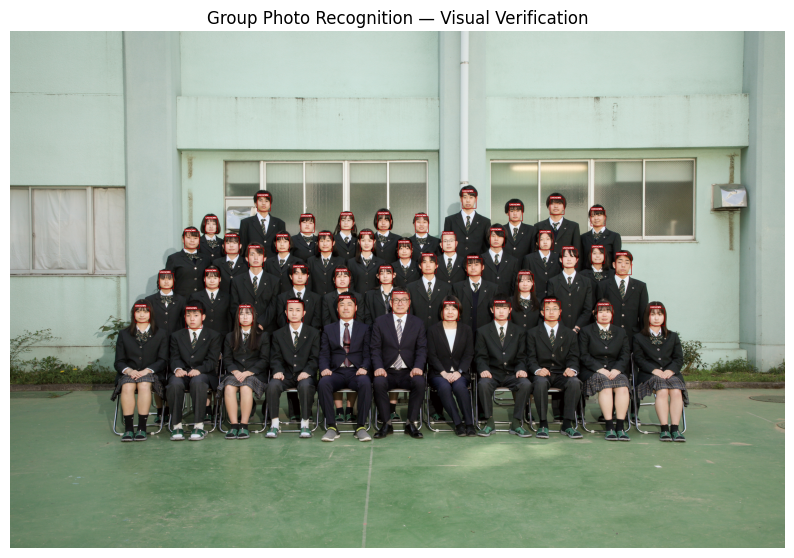

In [174]:
recognize_group_photo_visual(GROUP_PHOTO_PATH)


In [175]:
def match_face_strict(face_embedding, threshold=0.45):
    best_match = None
    best_score = -1
    best_profile = None

    for person_id, data in FACE_GALLERY.items():
        for emb in data["embeddings"]:
            score = cosine_similarity(face_embedding, emb)
            if score > best_score:
                best_score = score
                best_match = person_id
                best_profile = data["profile"]

    if best_score >= threshold:
        return best_match, best_score, best_profile

    return None, None, None


In [176]:
import cv2
import matplotlib.pyplot as plt

def recognize_group_photo_known_only(image_path):
    img = cv2.imread(image_path)
    faces = face_app.get(img)

    print("Total detected faces:", len(faces))

    matched_count = 0

    for face in faces:
        x1, y1, x2, y2 = map(int, face.bbox)

        person_id, score, profile = match_face_strict(face.embedding)

        # 🚫 SKIP UNKNOWN FACES COMPLETELY
        if profile is None:
            continue

        matched_count += 1

        role = profile.get("role", "UNKNOWN")
        name = profile.get("name", person_id)

        # ---------- COLOR ----------
        if role == "TEACHER":
            color = COLOR_TEACHER
        elif role == "STUDENT":
            color = COLOR_STUDENT
        else:
            color = COLOR_UNKNOWN

        # ---------- LABEL CONTENT ----------
        if role == "TEACHER":
            subject = profile.get("subject", "UNKNOWN")
            label_lines = [
                name,
                f"TEACHER | 教科: {subject}",
                f"Conf: {score:.2f}"
            ]
        else:
            cls = profile.get("class", "unknown")
            roll = profile.get("roll", "unknown")
            label_lines = [
                "STUDENT",
                f"Class: {cls} | Roll: {roll}",
                f"Conf: {score:.2f}"
            ]

        # ---------- DRAW ----------
        cv2.rectangle(img, (x1, y1), (x2, y2), color, 3)

        # Draw multi-line label
        y_offset = y1 - 10
        for line in reversed(label_lines):
            (w, h), _ = cv2.getTextSize(
                line, cv2.FONT_HERSHEY_SIMPLEX, 0.6, 2
            )
            cv2.rectangle(
                img,
                (x1, y_offset - h - 6),
                (x1 + w + 6, y_offset),
                color,
                -1
            )
            cv2.putText(
                img,
                line,
                (x1 + 3, y_offset - 3),
                cv2.FONT_HERSHEY_SIMPLEX,
                0.6,
                (255, 255, 255),
                2
            )
            y_offset -= h + 8

    print("Matched (known) faces:", matched_count)

    plt.figure(figsize=(12, 12))
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.title("Group Photo — Known Persons Only")
    plt.show()


Total detected faces: 42
Matched (known) faces: 0


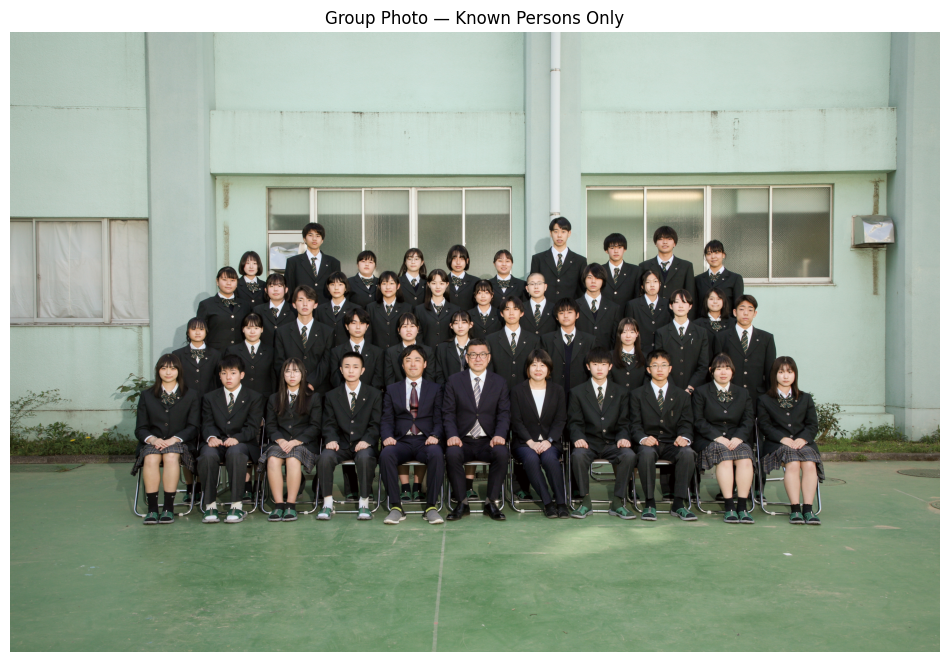

In [177]:
recognize_group_photo_known_only(GROUP_PHOTO_PATH)


In [178]:
import os

PERSONS_DIR = "/content/project/dataset/persons"

for person in sorted(os.listdir(PERSONS_DIR)):
    img_dir = os.path.join(PERSONS_DIR, person, "images")
    if os.path.exists(img_dir):
        print(person, "→", len(os.listdir(img_dir)), "images")


Person_000 → 4 images
Person_001 → 5 images
Person_002 → 4 images


In [179]:
from collections import defaultdict
import numpy as np

FACE_GALLERY = {}

def build_face_gallery():
    global FACE_GALLERY
    FACE_GALLERY = {}

    for person in os.listdir(PERSONS_DIR):
        img_dir = os.path.join(PERSONS_DIR, person, "images")
        if not os.path.exists(img_dir):
            continue

        embeddings = []

        for img_name in os.listdir(img_dir):
            img_path = os.path.join(img_dir, img_name)
            img = cv2.imread(img_path)
            faces = face_app.get(img)

            if not faces:
                continue

            # take largest face
            face = max(faces, key=lambda f: (f.bbox[2]-f.bbox[0])*(f.bbox[3]-f.bbox[1]))
            embeddings.append(face.embedding)

        if embeddings:
            FACE_GALLERY[person] = {
                "embeddings": embeddings,
                "profile": load_person_profile(person)
            }

    print("Face gallery built:", len(FACE_GALLERY))


In [180]:
build_face_gallery()


NameError: name 'load_person_profile' is not defined

In [182]:
import json
import os

def load_person_profile(person_id):
    profile_path = f"/content/project/dataset/persons/{person_id}/profile.json"

    if not os.path.exists(profile_path):
        # fallback safe profile
        return {
            "person_id": person_id,
            "role": "UNKNOWN",
            "name": person_id,
            "subject": None,
            "class": None,
            "roll": None,
            "confidence": 0.0,
            "verified": False
        }

    with open(profile_path, "r", encoding="utf-8") as f:
        return json.load(f)


In [183]:
import os

PERSONS_DIR = "/content/project/dataset/persons"

for person in sorted(os.listdir(PERSONS_DIR)):
    profile_path = os.path.join(PERSONS_DIR, person, "profile.json")
    print(person, "profile exists:", os.path.exists(profile_path))


Person_000 profile exists: False
Person_001 profile exists: False
Person_002 profile exists: False


In [184]:
!tree /content/project -L 5


/bin/bash: line 1: tree: command not found


In [185]:
!find /content/project -maxdepth 4 -type d


/content/project
/content/project/dataset
/content/project/dataset/faces
/content/project/dataset/embeddings
/content/project/dataset/preview
/content/project/dataset/logs
/content/project/dataset/raw
/content/project/dataset/persons
/content/project/dataset/persons/Person_001
/content/project/dataset/persons/Person_001/faces
/content/project/dataset/persons/Person_001/images
/content/project/dataset/persons/Person_001/card_crops
/content/project/dataset/persons/Person_001/card_vis
/content/project/dataset/persons/Person_000
/content/project/dataset/persons/Person_000/faces
/content/project/dataset/persons/Person_000/images
/content/project/dataset/persons/Person_000/card_crops
/content/project/dataset/persons/Person_000/card_vis
/content/project/dataset/persons/Person_002
/content/project/dataset/persons/Person_002/faces
/content/project/dataset/persons/Person_002/images
/content/project/dataset/persons/Person_002/card_crops
/content/project/dataset/persons/Person_002/card_vis
/conten

In [186]:
import json
import os

FINAL_DIR = "/content/project/dataset_final"

def load_profile_from_final(person_id):
    # Search teachers
    teachers_dir = os.path.join(FINAL_DIR, "teachers")
    if os.path.exists(teachers_dir):
        for name in os.listdir(teachers_dir):
            profile_path = os.path.join(teachers_dir, name, "profile.json")
            if os.path.exists(profile_path):
                with open(profile_path, "r", encoding="utf-8") as f:
                    prof = json.load(f)
                    if prof.get("person_id") == person_id:
                        return prof

    # Search students
    students_dir = os.path.join(FINAL_DIR, "students")
    for cls in os.listdir(students_dir):
        cls_dir = os.path.join(students_dir, cls)
        for roll in os.listdir(cls_dir):
            profile_path = os.path.join(cls_dir, roll, "profile.json")
            if os.path.exists(profile_path):
                with open(profile_path, "r", encoding="utf-8") as f:
                    prof = json.load(f)
                    if prof.get("person_id") == person_id:
                        return prof

    return None


In [187]:
FACE_GALLERY = {}

def build_face_gallery_from_final():
    global FACE_GALLERY
    FACE_GALLERY = {}

    PERSONS_DIR = "/content/project/dataset/persons"

    for person_id in os.listdir(PERSONS_DIR):
        img_dir = os.path.join(PERSONS_DIR, person_id, "images")
        if not os.path.exists(img_dir):
            continue

        embeddings = []

        for img_name in os.listdir(img_dir):
            img_path = os.path.join(img_dir, img_name)
            img = cv2.imread(img_path)
            faces = face_app.get(img)

            if not faces:
                continue

            # largest face
            face = max(
                faces,
                key=lambda f: (f.bbox[2]-f.bbox[0])*(f.bbox[3]-f.bbox[1])
            )
            embeddings.append(face.embedding)

        if not embeddings:
            continue

        profile = load_profile_from_final(person_id)
        if profile is None:
            print(f"⚠️ No profile found for {person_id}")
            continue

        FACE_GALLERY[person_id] = {
            "embeddings": embeddings,
            "profile": profile
        }

    print("✅ Face gallery built:", len(FACE_GALLERY))


In [188]:
build_face_gallery_from_final()


✅ Face gallery built: 3


Total detected faces: 42
Matched (known) faces: 1


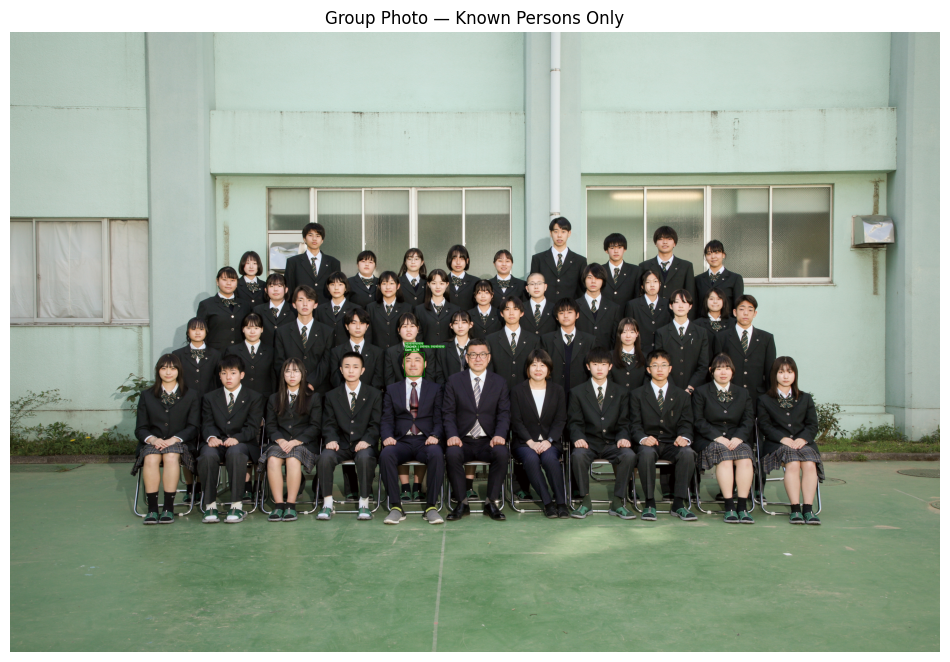

In [189]:
recognize_group_photo_known_only(GROUP_PHOTO_PATH)


Total detected faces: 42
Matched (known) faces: 1


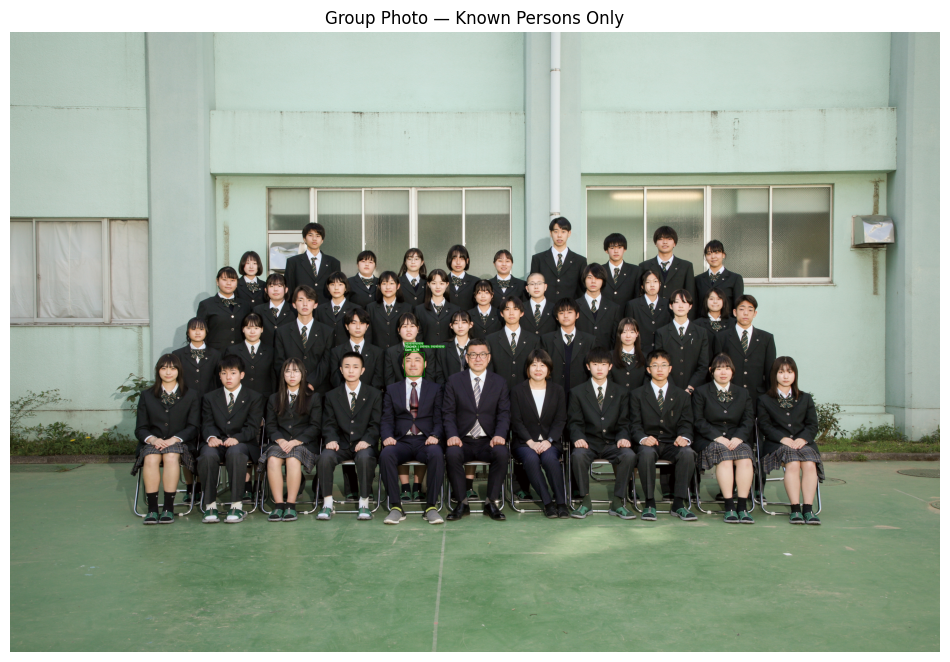

In [190]:
recognize_group_photo_known_only(GROUP_PHOTO_PATH)


In [191]:
import os

GROUP_PHOTO_PATH = "/content/drive/MyDrive/group_photos/class_group_01.jpg"

size_mb = os.path.getsize(GROUP_PHOTO_PATH) / (1024 * 1024)
print("Group photo size (MB):", round(size_mb, 2))


Group photo size (MB): 17.91


In [192]:
import cv2

img = cv2.imread(GROUP_PHOTO_PATH)
h, w = img.shape[:2]
print("Resolution:", w, "x", h)


Resolution: 6720 x 4480


In [193]:
def assert_group_photo_quality(path):
    import os, cv2
    size_mb = os.path.getsize(path) / (1024 * 1024)
    img = cv2.imread(path)
    h, w = img.shape[:2]

    if size_mb < 2 or min(h, w) < 2000:
        raise ValueError(
            f"❌ Group photo too low quality "
            f"({round(size_mb,2)} MB, {w}x{h})"
        )

    print("✅ Group photo quality OK:",
          round(size_mb,2), "MB", f"{w}x{h}")


In [194]:
assert_group_photo_quality(GROUP_PHOTO_PATH)


✅ Group photo quality OK: 17.91 MB 6720x4480


In [195]:
from pathlib import Path

GROUP_ROOT = Path("/content/drive/MyDrive/group_photos")

GROUP_IMAGES = [
    str(p) for p in GROUP_ROOT.rglob("*")
    if p.suffix.lower() in (".jpg", ".jpeg", ".png")
]

print("Total group photos found:", len(GROUP_IMAGES))
GROUP_IMAGES[:5]


Total group photos found: 13


['/content/drive/MyDrive/group_photos/class_group_01.jpg',
 '/content/drive/MyDrive/group_photos/1E_σàÑσ¡ªσ╝ÅΘ¢åσÉê72400019_Σ┐«µ¡ú.jpg',
 '/content/drive/MyDrive/group_photos/1F_σàÑσ¡ªσ╝ÅΘ¢åσÉê72400024.jpg',
 '/content/drive/MyDrive/group_photos/1A_σàÑσ¡ªσ╝ÅΘ¢åσÉê72400003.jpg',
 '/content/drive/MyDrive/group_photos/1B_σàÑσ¡ªσ╝ÅΘ¢åσÉê72400009.jpg']

In [196]:
import os, cv2

def is_high_quality_group_photo(path, min_mb=2.0, min_side=2000):
    size_mb = os.path.getsize(path) / (1024 * 1024)
    img = cv2.imread(path)
    if img is None:
        return False, "Unreadable"

    h, w = img.shape[:2]
    if size_mb < min_mb:
        return False, f"Low size ({round(size_mb,2)} MB)"
    if min(h, w) < min_side:
        return False, f"Low resolution ({w}x{h})"

    return True, "OK"


  0%|          | 0/13 [00:00<?, ?it/s]


🖼️ Processing: /content/drive/MyDrive/group_photos/class_group_01.jpg
Total detected faces: 42
Matched (known) faces: 1


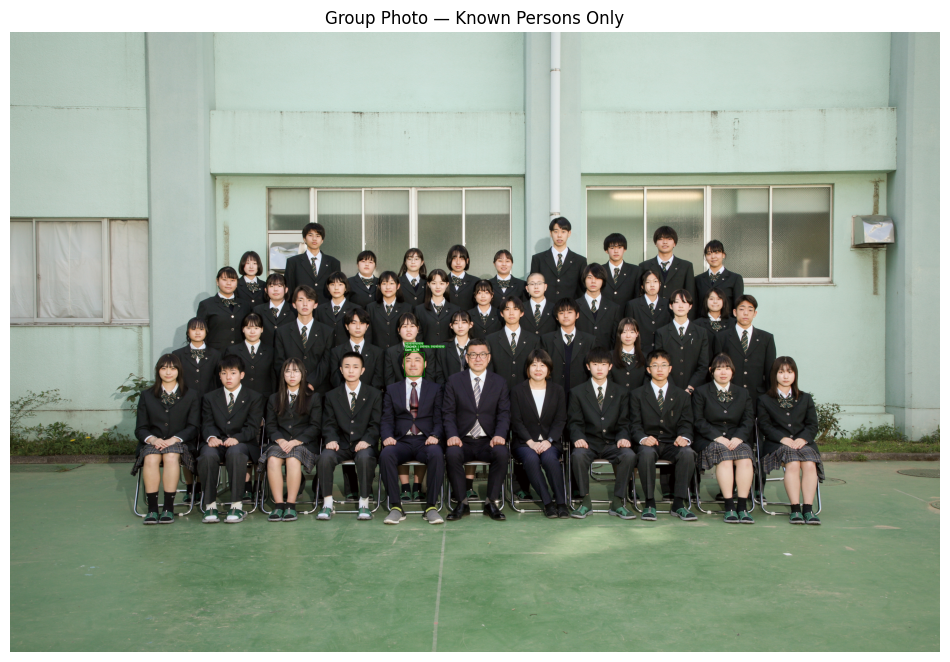

  8%|▊         | 1/13 [00:03<00:47,  3.98s/it]


🖼️ Processing: /content/drive/MyDrive/group_photos/1E_σàÑσ¡ªσ╝ÅΘ¢åσÉê72400019_Σ┐«µ¡ú.jpg
Total detected faces: 42
Matched (known) faces: 0


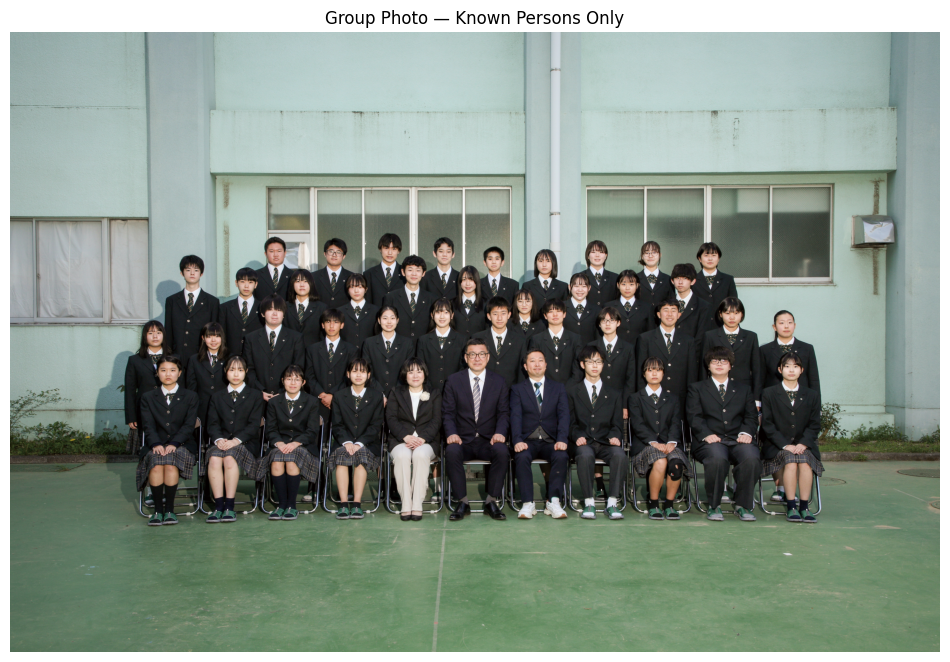

 15%|█▌        | 2/13 [00:08<00:49,  4.52s/it]


🖼️ Processing: /content/drive/MyDrive/group_photos/1F_σàÑσ¡ªσ╝ÅΘ¢åσÉê72400024.jpg
Total detected faces: 42
Matched (known) faces: 1


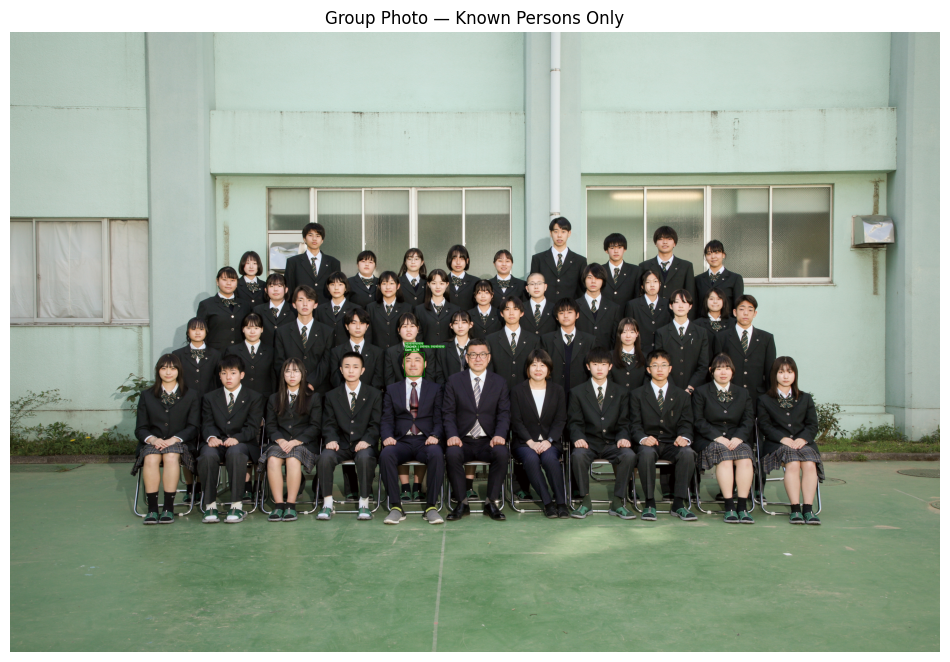

 23%|██▎       | 3/13 [00:13<00:44,  4.47s/it]


🖼️ Processing: /content/drive/MyDrive/group_photos/1A_σàÑσ¡ªσ╝ÅΘ¢åσÉê72400003.jpg
Total detected faces: 43
Matched (known) faces: 1


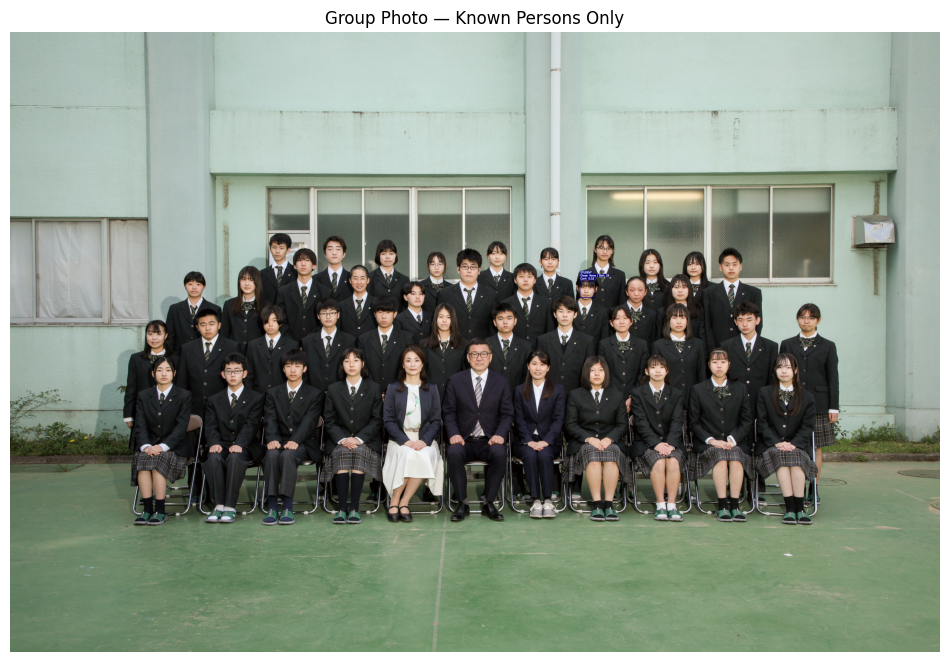

 31%|███       | 4/13 [00:18<00:44,  4.91s/it]


🖼️ Processing: /content/drive/MyDrive/group_photos/1B_σàÑσ¡ªσ╝ÅΘ¢åσÉê72400009.jpg
Total detected faces: 41
Matched (known) faces: 2


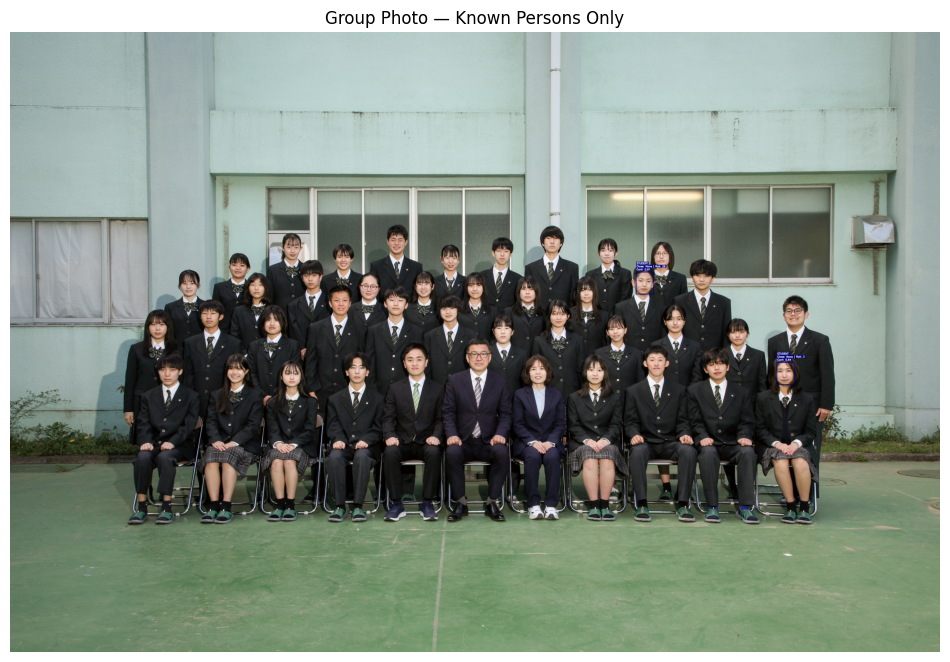

 38%|███▊      | 5/13 [00:23<00:39,  4.88s/it]


🖼️ Processing: /content/drive/MyDrive/group_photos/1C_σàÑσ¡ªσ╝ÅΘ¢åσÉê72400013.jpg
Total detected faces: 43
Matched (known) faces: 0


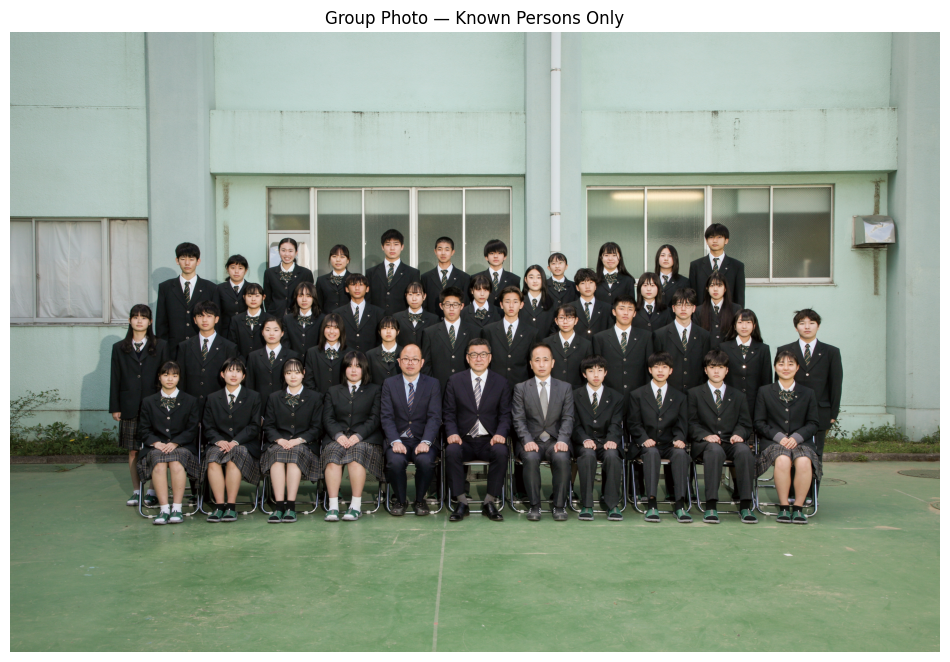

 46%|████▌     | 6/13 [00:28<00:33,  4.76s/it]


🖼️ Processing: /content/drive/MyDrive/group_photos/1D_σàÑσ¡ªσ╝ÅΘ¢åσÉê72400015.jpg
Total detected faces: 41
Matched (known) faces: 0


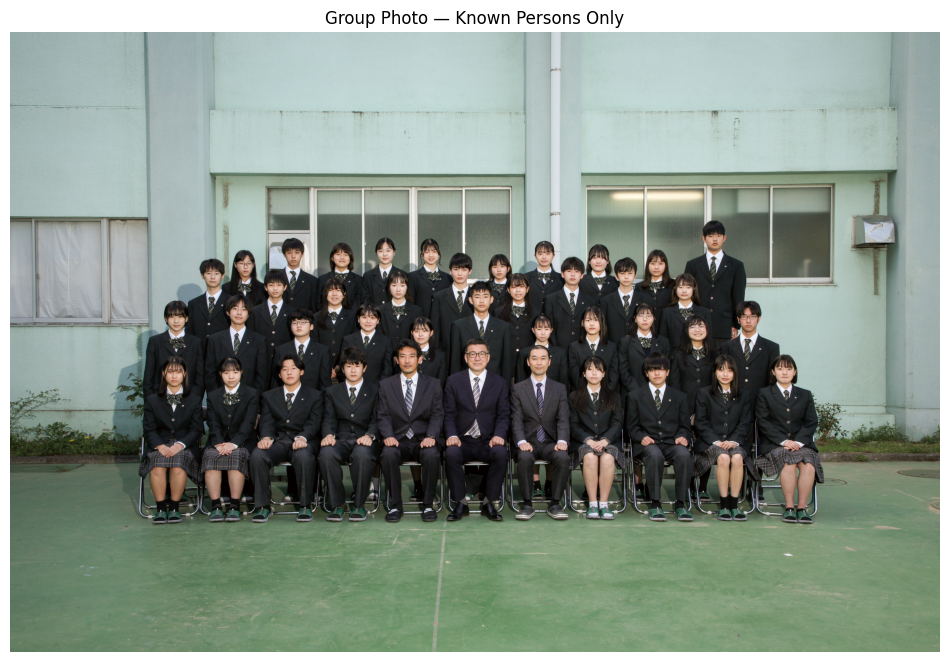

 54%|█████▍    | 7/13 [00:33<00:30,  5.07s/it]


🖼️ Processing: /content/drive/MyDrive/group_photos/2E_Σ┐«σ¡ªµùàΦíîΘ¢åσÉê91970047_Σ┐«µ¡ú.jpg
Total detected faces: 38
Matched (known) faces: 0


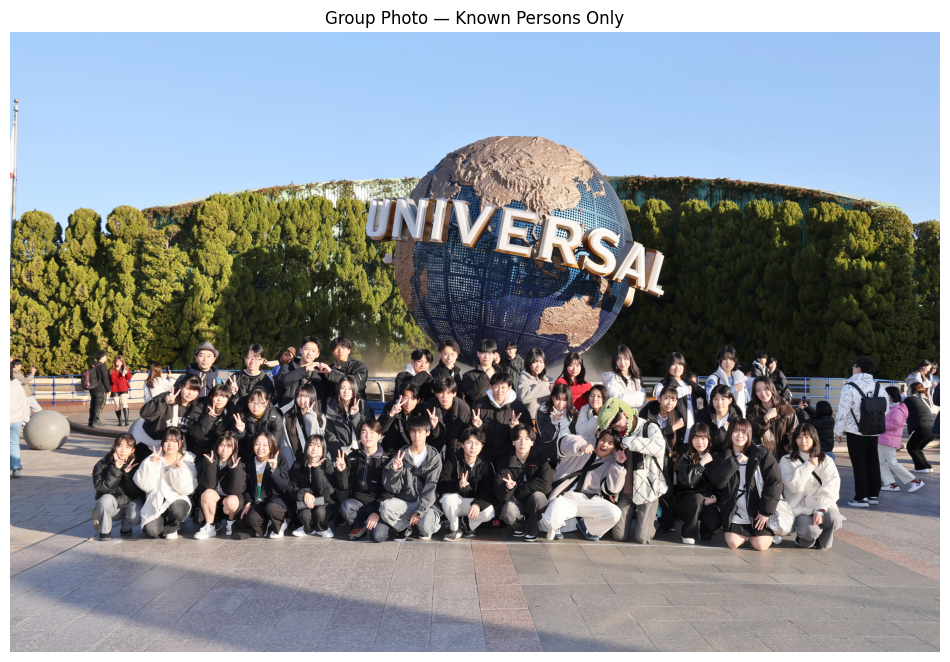

 62%|██████▏   | 8/13 [00:37<00:23,  4.73s/it]


🖼️ Processing: /content/drive/MyDrive/group_photos/2D_Σ┐«σ¡ªµùàΦíîΘ¢åσÉê91970041.jpg
Total detected faces: 39
Matched (known) faces: 0


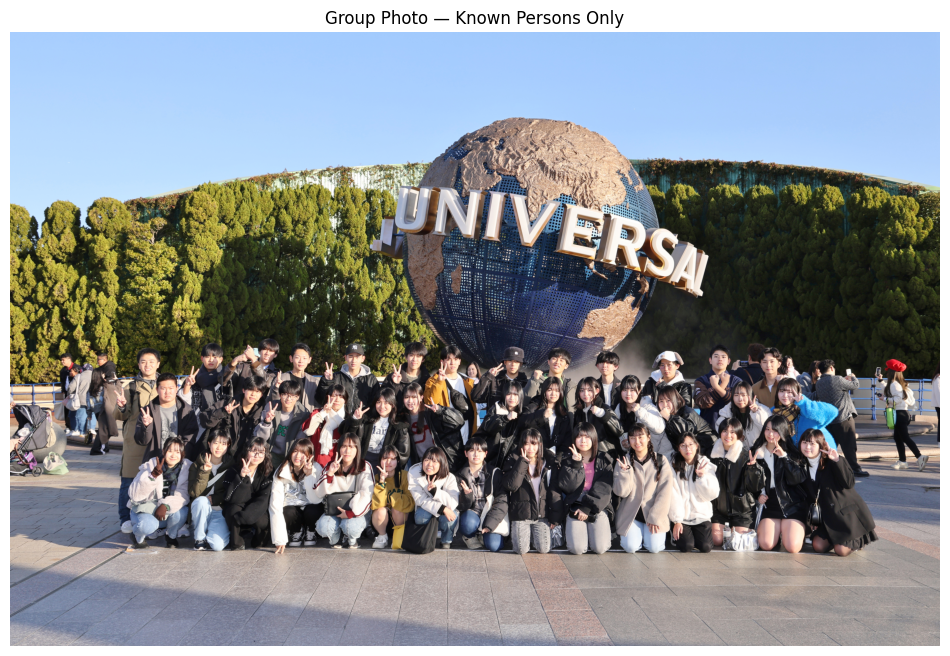

 69%|██████▉   | 9/13 [00:42<00:18,  4.54s/it]


🖼️ Processing: /content/drive/MyDrive/group_photos/2F_Σ┐«σ¡ªµùàΦíîΘ¢åσÉê91970036.jpg
Total detected faces: 39
Matched (known) faces: 0


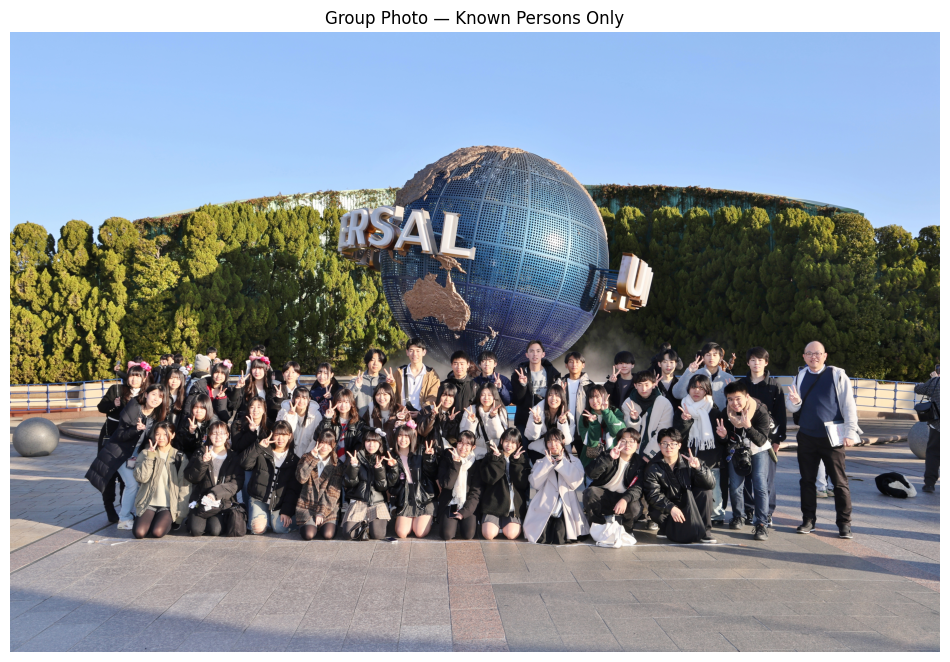

 77%|███████▋  | 10/13 [00:47<00:14,  4.67s/it]


🖼️ Processing: /content/drive/MyDrive/group_photos/2A_Σ┐«σ¡ªµùàΦíîΘ¢åσÉê91970055.jpg
Total detected faces: 40
Matched (known) faces: 4


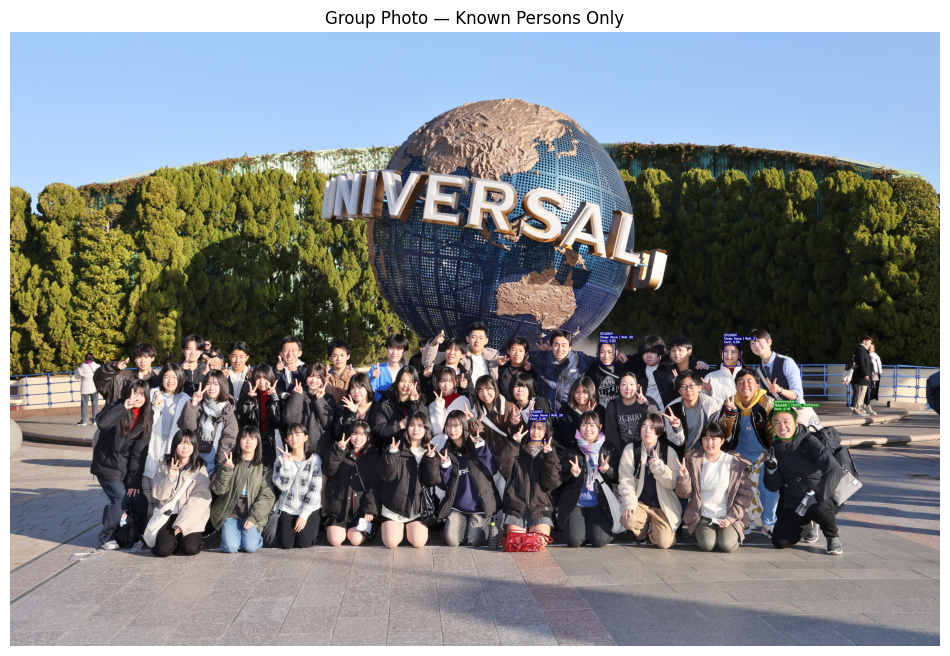

 85%|████████▍ | 11/13 [00:51<00:09,  4.55s/it]


🖼️ Processing: /content/drive/MyDrive/group_photos/2C_Σ┐«σ¡ªµùàΦíîΘ¢åσÉê91970060.jpg
Total detected faces: 33
Matched (known) faces: 0


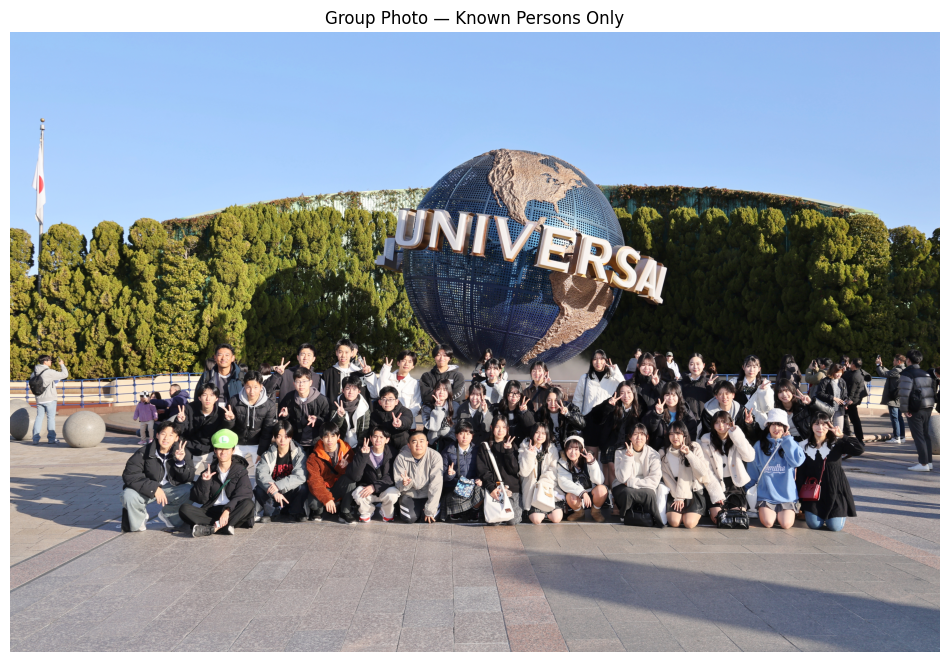

 92%|█████████▏| 12/13 [00:55<00:04,  4.33s/it]


🖼️ Processing: /content/drive/MyDrive/group_photos/2B_Σ┐«σ¡ªµùàΦíîΘ¢åσÉê91970050_Σ┐«µ¡ú.jpg
Total detected faces: 38
Matched (known) faces: 0


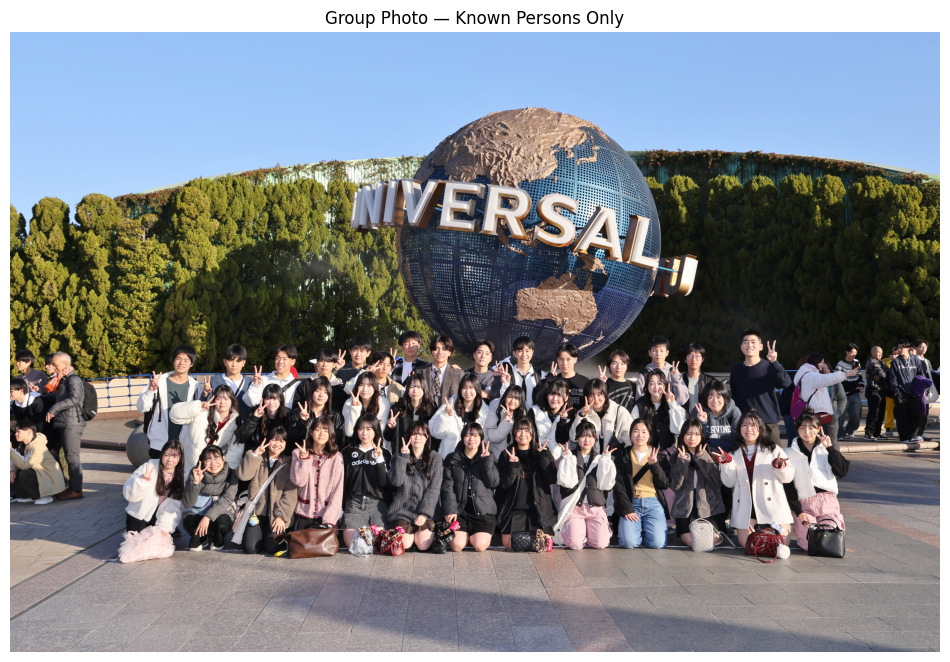

100%|██████████| 13/13 [01:00<00:00,  4.65s/it]


In [197]:
from tqdm import tqdm

RESULTS = []

for img_path in tqdm(GROUP_IMAGES):
    ok, reason = is_high_quality_group_photo(img_path)

    if not ok:
        print(f"⏭️ Skipping {img_path} — {reason}")
        continue

    print(f"\n🖼️ Processing: {img_path}")

    try:
        recognize_group_photo_known_only(img_path)
        RESULTS.append({
            "image": img_path,
            "status": "processed"
        })
    except Exception as e:
        print("❌ Failed:", img_path, e)
        RESULTS.append({
            "image": img_path,
            "status": "error",
            "error": str(e)
        })


In [198]:
COLOR_TEACHER = (0, 120, 255)   # dark orange
COLOR_STUDENT = (255, 120, 0)   # dark blue

def draw_face_boxes(img, matches):
    """
    matches = list of dicts:
      {
        'bbox': (x1,y1,x2,y2),
        'profile': profile_dict,
        'confidence': float,
        'id': 1,2,3...
      }
    """
    for m in matches:
        x1,y1,x2,y2 = m["bbox"]
        profile = m["profile"]

        color = COLOR_TEACHER if profile["role"] == "TEACHER" else COLOR_STUDENT

        cv2.rectangle(img, (x1,y1), (x2,y2), color, 3)
        cv2.putText(
            img,
            f"#{m['id']}",
            (x1, y1-10),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.8,
            color,
            2
        )


In [199]:
def draw_info_panel(img, matches):
    h, w = img.shape[:2]
    panel_width = 520

    panel = img.copy()
    panel = cv2.copyMakeBorder(
        panel, 0, 0, 0, panel_width,
        cv2.BORDER_CONSTANT,
        value=(245,245,245)
    )

    y = 40
    for m in matches:
        p = m["profile"]

        lines = [
            f"#{m['id']}  {p['name']}",
            f"Role: {p['role']}",
            f"Subject: {p.get('subject','-')}",
            f"Class: {p.get('class','-')}  Roll: {p.get('roll','-')}",
            f"Confidence: {m['confidence']:.2f}"
        ]

        for line in lines:
            cv2.putText(
                panel,
                line,
                (w + 20, y),
                cv2.FONT_HERSHEY_SIMPLEX,
                0.7,
                (20,20,20),
                2
            )
            y += 28

        y += 20

    return panel


In [203]:
import json, os
from pathlib import Path

OUTPUT_ROOT = "/content/drive/MyDrive/group_results"
os.makedirs(OUTPUT_ROOT, exist_ok=True)

def save_group_result(image_path, final_img, matches):
    if not matches:
        return  # ⛔ no known person → no save

    group_name = Path(image_path).stem
    out_dir = os.path.join(OUTPUT_ROOT, group_name)
    os.makedirs(out_dir, exist_ok=True)

    # Save image (NO quality loss)
    img_out = os.path.join(out_dir, "image.png")
    cv2.imwrite(img_out, final_img)

    # Save data
    data = []
    for m in matches:
        p = m["profile"]
        data.append({
            "id": m["id"],
            "name": p["name"],
            "role": p["role"],
            "subject": p.get("subject"),
            "class": p.get("class"),
            "roll": p.get("roll"),
            "confidence": float(m["confidence"])
        })

    with open(os.path.join(out_dir, "data.json"), "w", encoding="utf-8") as f:
        json.dump(data, f, ensure_ascii=False, indent=2)

    print(f"💾 Saved group result → {out_dir}")


In [204]:
def process_group_photo_final(image_path):
    img = cv2.imread(image_path)
    faces = face_app.get(img)

    matches = []
    person_id_counter = 1

    for face in faces:
        pid, score, profile = match_face_strict(face.embedding)

        if profile is None:
            continue

        x1,y1,x2,y2 = map(int, face.bbox)

        matches.append({
            "id": person_id_counter,
            "bbox": (x1,y1,x2,y2),
            "profile": profile,
            "confidence": score
        })
        person_id_counter += 1

    if not matches:
        print("No known persons found.")
        return

    draw_face_boxes(img, matches)
    final_img = draw_info_panel(img, matches)

    save_group_result(image_path, final_img, matches)

    return final_img


In [205]:
for img_path in GROUP_IMAGES:
    ok, _ = is_high_quality_group_photo(img_path)
    if not ok:
        continue

    print("\nProcessing:", img_path)
    process_group_photo_final(img_path)



Processing: /content/drive/MyDrive/group_photos/class_group_01.jpg
💾 Saved group result → /content/drive/MyDrive/group_results/class_group_01

Processing: /content/drive/MyDrive/group_photos/1E_σàÑσ¡ªσ╝ÅΘ¢åσÉê72400019_Σ┐«µ¡ú.jpg
No known persons found.

Processing: /content/drive/MyDrive/group_photos/1F_σàÑσ¡ªσ╝ÅΘ¢åσÉê72400024.jpg
💾 Saved group result → /content/drive/MyDrive/group_results/1F_σàÑσ¡ªσ╝ÅΘ¢åσÉê72400024

Processing: /content/drive/MyDrive/group_photos/1A_σàÑσ¡ªσ╝ÅΘ¢åσÉê72400003.jpg
💾 Saved group result → /content/drive/MyDrive/group_results/1A_σàÑσ¡ªσ╝ÅΘ¢åσÉê72400003

Processing: /content/drive/MyDrive/group_photos/1B_σàÑσ¡ªσ╝ÅΘ¢åσÉê72400009.jpg
💾 Saved group result → /content/drive/MyDrive/group_results/1B_σàÑσ¡ªσ╝ÅΘ¢åσÉê72400009

Processing: /content/drive/MyDrive/group_photos/1C_σàÑσ¡ªσ╝ÅΘ¢åσÉê72400013.jpg
No known persons found.

Processing: /content/drive/MyDrive/group_photos/1D_σàÑσ¡ªσ╝ÅΘ¢åσÉê72400015.jpg
No kno

In [206]:
import matplotlib.pyplot as plt
import cv2

def process_group_photo_final(image_path, show=True):
    img = cv2.imread(image_path)
    faces = face_app.get(img)

    matches = []
    person_id_counter = 1

    for face in faces:
        pid, score, profile = match_face_strict(face.embedding)

        if profile is None:
            continue

        x1, y1, x2, y2 = map(int, face.bbox)

        matches.append({
            "id": person_id_counter,
            "bbox": (x1, y1, x2, y2),
            "profile": profile,
            "confidence": float(score)
        })
        person_id_counter += 1

    if not matches:
        print("No known persons found.")
        return None

    # draw boxes + panel
    draw_face_boxes(img, matches)
    final_img = draw_info_panel(img, matches)

    # save result
    save_group_result(image_path, final_img, matches)

    # 👁️ VISUAL DISPLAY (CEO DEMO)
    if show:
        plt.figure(figsize=(14, 10))
        plt.imshow(cv2.cvtColor(final_img, cv2.COLOR_BGR2RGB))
        plt.title(f"Recognized Persons — {image_path.split('/')[-1]}")
        plt.axis("off")
        plt.show()

    return final_img



Processing: /content/drive/MyDrive/group_photos/class_group_01.jpg
💾 Saved group result → /content/drive/MyDrive/group_results/class_group_01


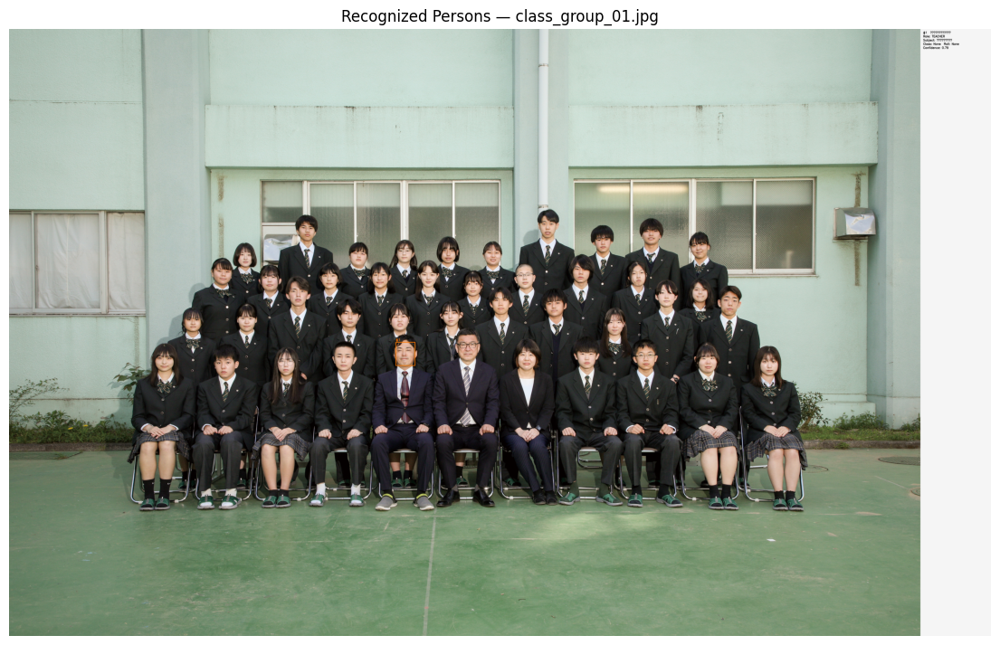


Processing: /content/drive/MyDrive/group_photos/1E_σàÑσ¡ªσ╝ÅΘ¢åσÉê72400019_Σ┐«µ¡ú.jpg
No known persons found.

Processing: /content/drive/MyDrive/group_photos/1F_σàÑσ¡ªσ╝ÅΘ¢åσÉê72400024.jpg
💾 Saved group result → /content/drive/MyDrive/group_results/1F_σàÑσ¡ªσ╝ÅΘ¢åσÉê72400024


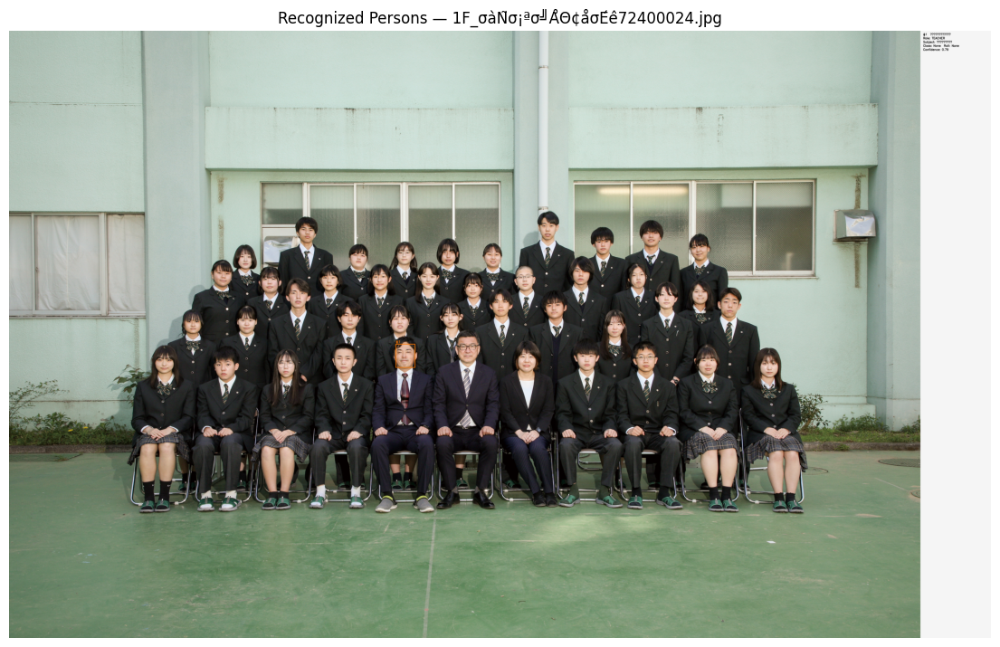


Processing: /content/drive/MyDrive/group_photos/1A_σàÑσ¡ªσ╝ÅΘ¢åσÉê72400003.jpg
💾 Saved group result → /content/drive/MyDrive/group_results/1A_σàÑσ¡ªσ╝ÅΘ¢åσÉê72400003


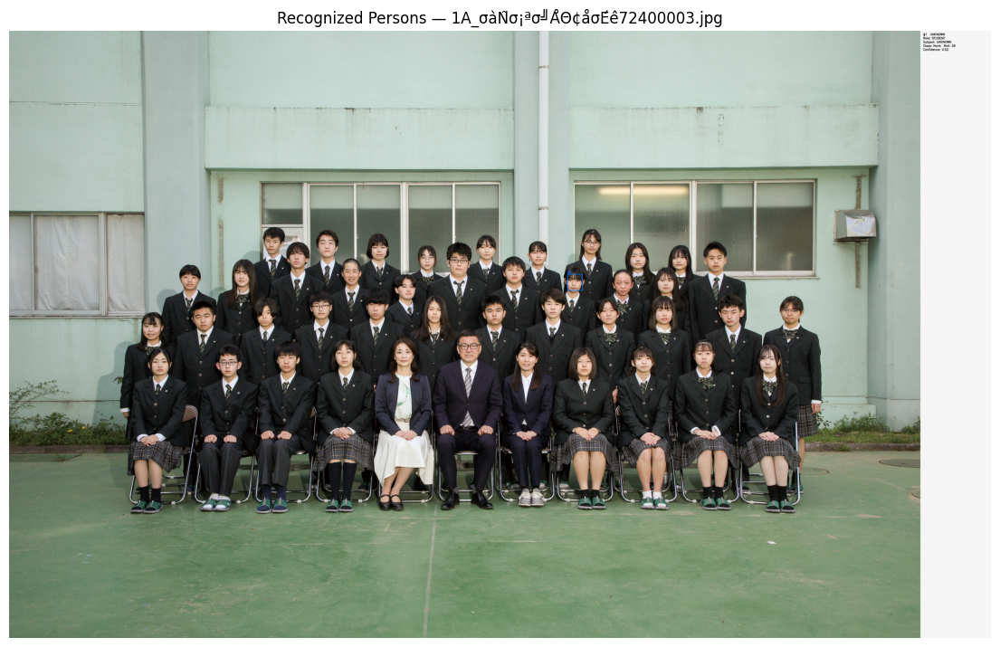


Processing: /content/drive/MyDrive/group_photos/1B_σàÑσ¡ªσ╝ÅΘ¢åσÉê72400009.jpg
💾 Saved group result → /content/drive/MyDrive/group_results/1B_σàÑσ¡ªσ╝ÅΘ¢åσÉê72400009


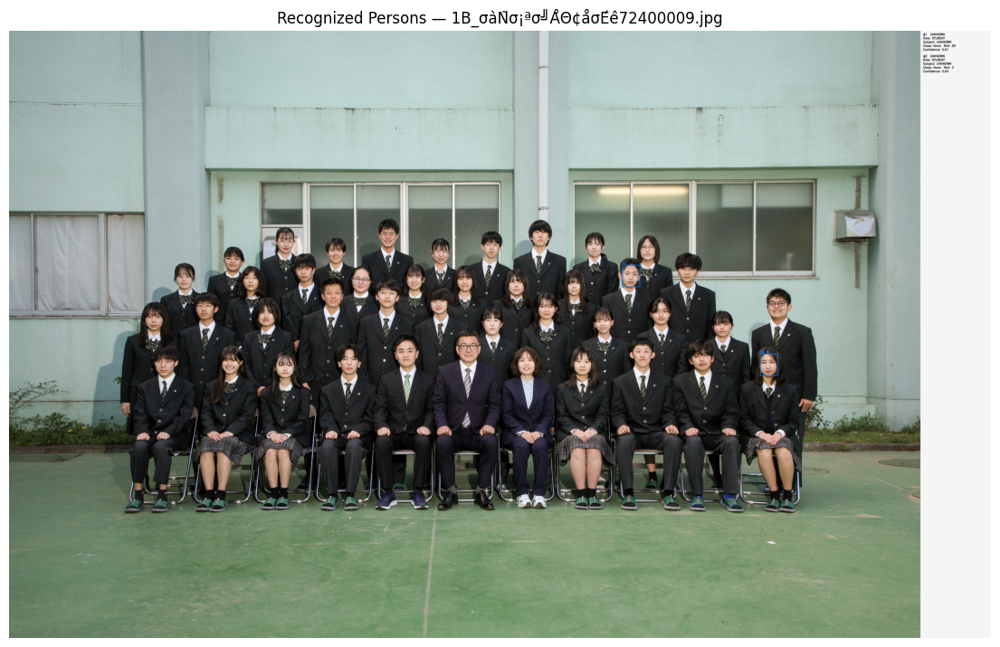


Processing: /content/drive/MyDrive/group_photos/1C_σàÑσ¡ªσ╝ÅΘ¢åσÉê72400013.jpg
No known persons found.

Processing: /content/drive/MyDrive/group_photos/1D_σàÑσ¡ªσ╝ÅΘ¢åσÉê72400015.jpg
No known persons found.

Processing: /content/drive/MyDrive/group_photos/2E_Σ┐«σ¡ªµùàΦíîΘ¢åσÉê91970047_Σ┐«µ¡ú.jpg
No known persons found.

Processing: /content/drive/MyDrive/group_photos/2D_Σ┐«σ¡ªµùàΦíîΘ¢åσÉê91970041.jpg
No known persons found.

Processing: /content/drive/MyDrive/group_photos/2F_Σ┐«σ¡ªµùàΦíîΘ¢åσÉê91970036.jpg
No known persons found.

Processing: /content/drive/MyDrive/group_photos/2A_Σ┐«σ¡ªµùàΦíîΘ¢åσÉê91970055.jpg
💾 Saved group result → /content/drive/MyDrive/group_results/2A_Σ┐«σ¡ªµùàΦíîΘ¢åσÉê91970055


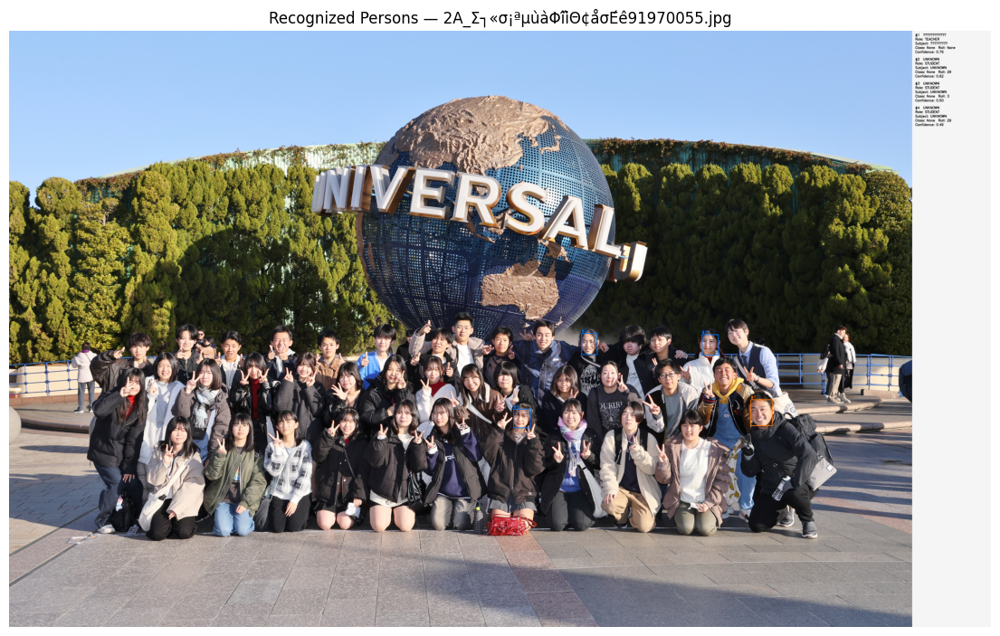


Processing: /content/drive/MyDrive/group_photos/2C_Σ┐«σ¡ªµùàΦíîΘ¢åσÉê91970060.jpg
No known persons found.

Processing: /content/drive/MyDrive/group_photos/2B_Σ┐«σ¡ªµùàΦíîΘ¢åσÉê91970050_Σ┐«µ¡ú.jpg
No known persons found.


In [207]:
for img_path in GROUP_IMAGES:
    ok, reason = is_high_quality_group_photo(img_path)

    if not ok:
        continue

    print("\nProcessing:", img_path)
    process_group_photo_final(img_path, show=True)
